### Import Libraries and Data

In [1]:
# Import libraries
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import tensorflow as tf
import joblib
import lime
import lime.lime_tabular
from sklearn.model_selection import train_test_split, GridSearchCV, learning_curve, cross_validate
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import GradientBoostingClassifier, RandomForestClassifier, VotingClassifier
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report, precision_score, recall_score, f1_score, accuracy_score
from sklearn.preprocessing import StandardScaler
from xgboost import XGBClassifier
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, Input
from tensorflow.keras.callbacks import LearningRateScheduler, EarlyStopping

# set the theme for seaborn
sns.set(style="whitegrid")

In [2]:
# Import data
data = pd.read_csv('preprocessed_data.csv')

In [3]:
data.shape

(40490, 9)

### Data Modelling

In [4]:
# Define x and y
x = data.drop(columns=['stroke'])
y = data['stroke']

# Split dataset into 80% training and 20% testing data
risk_factors_train, risk_factors_test, target_train, target_test = train_test_split(x, y, test_size=0.2, random_state=42)

In [5]:
print(f"Training features size: ", risk_factors_train.shape[0])
print(f"Testing features size: ", risk_factors_test.shape[0])
print(f"Training target size: ", target_train.shape[0])
print(f"Testing target size: ", target_test.shape[0])

Training features size:  32392
Testing features size:  8098
Training target size:  32392
Testing target size:  8098


#### Data Standartization 

In [8]:
# Fit and transform the training and testing data
scaler = StandardScaler()
risk_factors_train = scaler.fit_transform(risk_factors_train)
risk_factors_test= scaler.transform(risk_factors_test)

In [25]:
# Convert to data frame and save in csv file for further use
risk_factors_train_df = pd.DataFrame(risk_factors_train, columns=x.columns)  
risk_factors_test_df = pd.DataFrame(risk_factors_test, columns=x.columns)    

# risk_factors_train_df.to_csv('risk_factors_train.csv', index=False)
# risk_factors_test_df.to_csv('risk_factors_test.csv', index=False)

#### Functions

In [13]:
# Function to plot learning curve
def plot_learning_curve(estimator, x, y, cv, scoring):
    train_sizes, train_scores, test_scores = learning_curve(estimator, x, y, cv=cv, train_sizes=np.linspace(0.1, 1.0, 10), 
                                                            scoring=scoring, n_jobs=-1, random_state=42)
    
    train_scores_mean = np.mean(train_scores, axis=1)
    train_scores_std = np.std(train_scores, axis=1)
    test_scores_mean = np.mean(test_scores, axis=1)
    test_scores_std = np.std(test_scores, axis=1)
    
    # Plot the learning curves
    plt.figure(figsize=(6, 4))
    plt.title("Learning Curve")
    plt.xlabel('Training Instances')
    plt.ylabel('Accuracy')
    plt.plot(train_sizes, train_scores_mean, 'o-', color="r", label="Training score")
    plt.plot(train_sizes, test_scores_mean, 'o-', color="g", label="Cross-validation score")
    
    plt.grid()
    
    plt.fill_between(train_sizes, train_scores_mean - train_scores_std,
                     train_scores_mean + train_scores_std, alpha=0.1,
                     color="r")
    plt.fill_between(train_sizes, test_scores_mean - test_scores_std,
                     test_scores_mean + test_scores_std, alpha=0.1, color="g")
    
    plt.legend(loc="best")
    return plt

In [14]:
# Function to plot impact of features on model
def evaluate_feature_impact(x, risk_factors_train, risk_factors_test, target_train, target_test, model):
    # Create empty list to store accuracy scores
    train_accuracies = []
    test_accuracies = []

    # Convert arrays back to DataFrame
    risk_factors_train_df = pd.DataFrame(risk_factors_train, columns=x.columns)
    risk_factors_test_df = pd.DataFrame(risk_factors_test, columns=x.columns)
    risk_factors_train_copy = risk_factors_train_df.copy()
    risk_factors_test_copy = risk_factors_test_df.copy()

    # Loop through each feature
    for feature in x.columns:
        
        reduced_risk_factors_train = risk_factors_train_copy.drop(columns=[feature])
        reduced_risk_factors_test = risk_factors_test_copy.drop(columns=[feature])

        # Train the model with reduced training data
        model.fit(reduced_risk_factors_train, target_train)

        # Test the model with reduced testing data
        dt_target_pred_train = model.predict(reduced_risk_factors_train)
        dt_target_pred_test = model.predict(reduced_risk_factors_test)

        # Calculate accuracy
        train_accuracy = accuracy_score(target_train, dt_target_pred_train)
        test_accuracy = accuracy_score(target_test, dt_target_pred_test)

        train_accuracies.append(train_accuracy)
        test_accuracies.append(test_accuracy)

        print(f"Feature removed: {feature}")
        print(f"Training Accuracy: {train_accuracy:.4f}")
        print(f"Testing Accuracy: {test_accuracy:.4f}\n")

    # Plot the graph
    plt.figure(figsize=(8, 5))
    plt.plot(range(len(x.columns)), train_accuracies, marker='o', label='Train Accuracy')
    plt.plot(range(len(x.columns)), test_accuracies, marker='s', label='Test Accuracy')
    plt.xticks(range(len(x.columns)), x.columns, rotation=45)
    plt.xlabel('Removed Feature')
    plt.ylabel('Accuracy')
    plt.title('Impact of Removing Features on Model Accuracy')
    plt.legend()
    plt.tight_layout()
    plt.show()

In [15]:
from sklearn.inspection import permutation_importance

def plot_permutation_importance(model, test_features, test_target, feature_names, title='Feature Importance', scoring='accuracy', n_repeats=10, random_state=42):
    # Compute permutation importance
    result = permutation_importance(model, test_features, test_target, n_repeats=n_repeats, random_state=random_state, scoring=scoring)
    perm_importances = result.importances_mean
    perm_importances_std = result.importances_std

    assert len(perm_importances) == len(feature_names), "Mismatch in feature importances and feature names lengths."

    # Create a DataFrame for better visualization
    feature_importance_df = pd.DataFrame({
        'Feature': feature_names,
        'Importance': perm_importances,
        'Importance Std': perm_importances_std
    })
    feature_importance_df = feature_importance_df.sort_values(by='Importance', ascending=False)

    # Plot feature importance
    plt.figure(figsize=(8, 5))
    sns.barplot(x='Importance', y='Feature', data=feature_importance_df, palette='viridis', ci=None)
    plt.errorbar(feature_importance_df['Importance'], feature_importance_df['Feature'], 
                 xerr=feature_importance_df['Importance Std'], fmt='none', c='gray', capsize=3)
    plt.title(title)
    plt.xlabel('Importance')
    plt.ylabel('Feature')
    plt.show()

In [16]:
# LIME explaination

# Columns that had log transformation
log_transformed_columns = ['avg_glucose_level', 'bmi']

# Function to inverse transform log and standardization
def inverse_transform(instance, scaler, log_transformed_columns):
    original_instance = scaler.inverse_transform(instance)
    original_instance_df = pd.DataFrame(original_instance, columns=x.columns)
    for column in log_transformed_columns:
        original_instance_df[column] = np.expm1(original_instance_df[column])  # Inverse of log transformation
    return original_instance_df.values

def explain_stroke_instance(risk_factors_train, risk_factors_test, target_test, model, x, target_num):
    # Find indices for specific target value
    stroke_indices = np.where(target_test == target_num)[0]

    # Select a random instance
    instance_index = np.random.choice(stroke_indices)
    standardized_instance = risk_factors_test[instance_index].reshape(1, -1)

    # Initialize the LIME explainer with original data
    explainer = lime.lime_tabular.LimeTabularExplainer(
        training_data=risk_factors_train,  
        feature_names=x.columns,
        class_names=['No Stroke', 'Stroke'],
        mode='classification'
    )

    # Generate the explanation for the selected instance
    exp = explainer.explain_instance(
        data_row=standardized_instance[0],  # Use the original instance
        predict_fn=lambda x: model.predict_proba(x),  # Scale the data before prediction
        num_features=5
    )

    # Inverse transform to get original values
    original_values = inverse_transform(standardized_instance, scaler, log_transformed_columns)

    # Display the explanation in text with original values
    print("Original Values:", pd.DataFrame(original_values, columns=x.columns))

    # Display the explanation in text
    exp.show_in_notebook(show_table=True)

    return exp

In [17]:
# The data is history data so named as stroke and no stroke, instead of mentioning high or low risk
target_names = ['No Stroke', 'Stroke']

In [18]:
# Initialize the DataFrame to store the evaluation matrix scores for further use (base models)
columns = ['Model', 'Accuracy', 'Precision', 'Recall', 'F1 Score', 'Specificity']
metrics_df = pd.DataFrame(columns=columns)

#### Decision Tree (DT)

##### Before Hyperparameter Tuning

Before Hyperparamater Tuning: 
Training Accuracy:  1.0
Testing Accuracy:  0.9878982464806125
Specificity (True Negative Rate):  0.9850086016220202

Classification Report: 
               precision    recall  f1-score   support

   No Stroke     0.9909    0.9850    0.9879      4069
      Stroke     0.9849    0.9908    0.9879      4029

    accuracy                         0.9879      8098
   macro avg     0.9879    0.9879    0.9879      8098
weighted avg     0.9879    0.9879    0.9879      8098



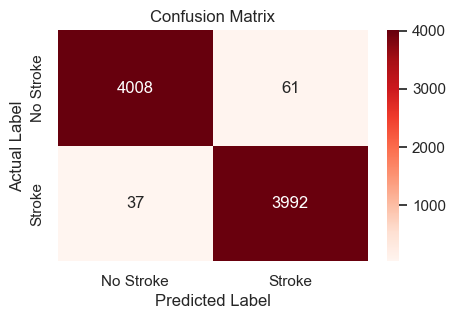

In [14]:
# Initialize the RF model
dt_model = DecisionTreeClassifier(random_state=42)

# Train the model with training data
dt_model.fit(risk_factors_train, target_train)

# Test the model with training and testing data
dt_target_pred_train = dt_model.predict(risk_factors_train)
dt_target_pred_test = dt_model.predict(risk_factors_test)

# Calculate accuracy
dt_train_accuracy = accuracy_score(target_train, dt_target_pred_train)
dt_test_accuracy = accuracy_score(target_test, dt_target_pred_test)
# Calculate specificity (true negative rate)
test_conf_matrix = confusion_matrix(target_test, dt_target_pred_test)
tn, fp, fn, tp = test_conf_matrix.ravel()
specificity = tn / (tn + fp)

# Classification report
dt_test_report = classification_report(target_test, dt_target_pred_test, target_names=target_names, digits=4)

print("Before Hyperparamater Tuning: ")
print("Training Accuracy: ", dt_train_accuracy)
print("Testing Accuracy: ", dt_test_accuracy)
print("Specificity (True Negative Rate): ", specificity)
print("\nClassification Report: \n", dt_test_report)

# Confusion Matrix
test_conf_matrix = confusion_matrix(target_test, dt_target_pred_test)
plt.figure(figsize=(5, 3))
sns.heatmap(test_conf_matrix, annot=True, cmap='Reds', fmt='d', xticklabels=target_names, yticklabels=target_names)
plt.xlabel('Predicted Label')
plt.ylabel('Actual Label')
plt.title('Confusion Matrix')
plt.show()

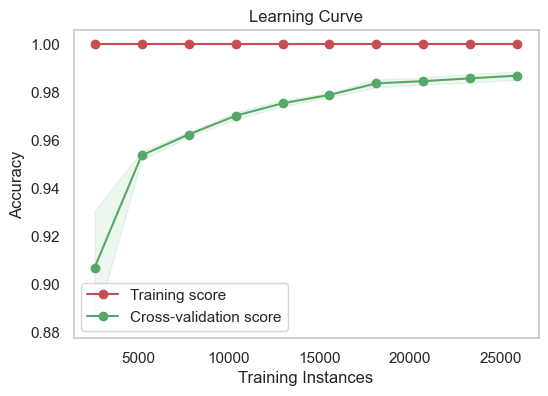

In [15]:
plot_learning_curve(dt_model, risk_factors_train, target_train, 5, scoring='accuracy')
plt.show()

C:\Users\tsfat\AppData\Local\Temp\ipykernel_17388\280330674.py:21: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='Importance', y='Feature', data=feature_importance_df, palette='viridis', ci=None)
C:\Users\tsfat\AppData\Local\Temp\ipykernel_17388\280330674.py:21: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Importance', y='Feature', data=feature_importance_df, palette='viridis', ci=None)


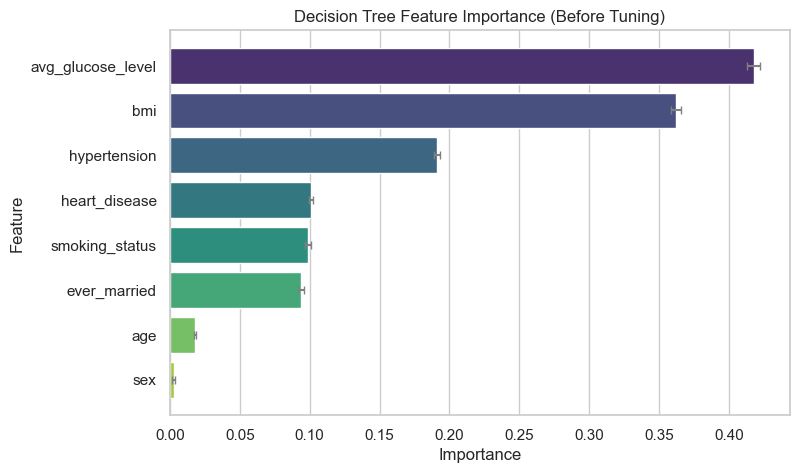

In [18]:
plot_permutation_importance(dt_model, risk_factors_test, target_test, x.columns, 
                            title='Decision Tree Feature Importance (Before Tuning)', scoring='accuracy')

Feature removed: sex
Training Accuracy: 1.0000
Testing Accuracy: 0.9883

Feature removed: age
Training Accuracy: 1.0000
Testing Accuracy: 0.9957

Feature removed: hypertension
Training Accuracy: 1.0000
Testing Accuracy: 0.9843

Feature removed: heart_disease
Training Accuracy: 1.0000
Testing Accuracy: 0.9873

Feature removed: ever_married
Training Accuracy: 1.0000
Testing Accuracy: 0.9931

Feature removed: avg_glucose_level
Training Accuracy: 0.9680
Testing Accuracy: 0.8723

Feature removed: bmi
Training Accuracy: 0.9991
Testing Accuracy: 0.9807

Feature removed: smoking_status
Training Accuracy: 1.0000
Testing Accuracy: 0.9889



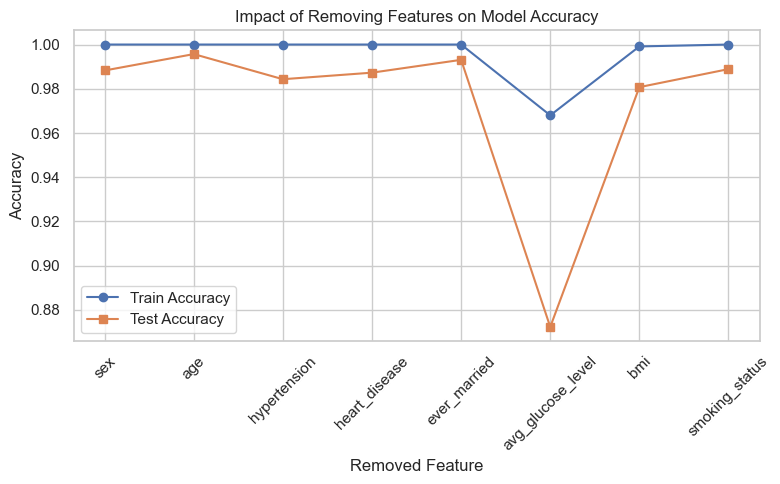

In [19]:
# Evaluate feature impact
evaluate_feature_impact(x, risk_factors_train, risk_factors_test, target_train, target_test, dt_model)

##### Hyperparameter Tuning

In [20]:
# Hyperparameter tuning
param_grid = {
    'max_depth': [3, 5, None],
    'min_samples_split': [20],
    'min_samples_leaf': [10, 20, 30],
    'max_features': ['sqrt', 'log2', None],
    'max_leaf_nodes': [10, 20, None]
}

# Use grid search to find the best hyperparameters
dt_grid_search = GridSearchCV(dt_model, param_grid, cv=5, n_jobs=-1, verbose=1, refit=True)

dt_grid_search.fit(risk_factors_train, target_train)

print("Best Hyperparameters:", dt_grid_search.best_params_)
print("Best Mean Cross-validated Score:", dt_grid_search.best_score_)

Fitting 5 folds for each of 81 candidates, totalling 405 fits
Best Hyperparameters: {'max_depth': None, 'max_features': None, 'max_leaf_nodes': None, 'min_samples_leaf': 10, 'min_samples_split': 20}
Best Mean Cross-validated Score: 0.970671827822293


##### After Hyperparameter Tuning 

After Hyperparamater Tuning: 
Training Accuracy:  0.9833600889108421
Testing Accuracy:  0.9755495183996048
Specificity (True Negative Rate):  0.9682968788400098

Classification Report: 
               precision    recall  f1-score   support

   No Stroke     0.9828    0.9683    0.9755      4069
      Stroke     0.9685    0.9829    0.9756      4029

    accuracy                         0.9755      8098
   macro avg     0.9756    0.9756    0.9755      8098
weighted avg     0.9757    0.9755    0.9755      8098



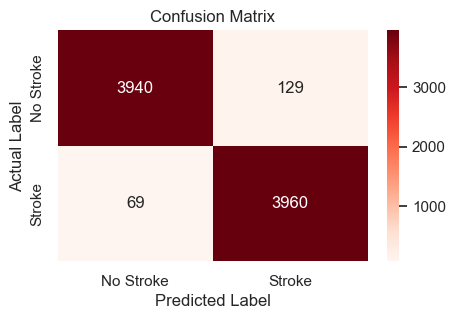

In [19]:
# Best hyperparameters obtained from grid search
dt_best_params = {'max_depth': None, 
               'max_features': None, 
               'max_leaf_nodes': None, 
               'min_samples_leaf': 10, 
               'min_samples_split': 20}

# Initialize a new RF model with the best hyperparameters
dt_tuned_model = DecisionTreeClassifier(**dt_best_params, random_state=42)

# Train the model with training data
dt_tuned_model.fit(risk_factors_train, target_train)

# Test the model with training and testing data
dt_target_pred_train = dt_tuned_model.predict(risk_factors_train)
dt_target_pred_test = dt_tuned_model.predict(risk_factors_test)

# Calculate accuracy
dt_train_accuracy = accuracy_score(target_train, dt_target_pred_train)
dt_test_accuracy = accuracy_score(target_test, dt_target_pred_test)
# Calculate specificity (true negative rate)
test_conf_matrix = confusion_matrix(target_test, dt_target_pred_test)
tn, fp, fn, tp = test_conf_matrix.ravel()
specificity = tn / (tn + fp)

# Calculate precision, recall, F1-score
precision = precision_score(target_test, dt_target_pred_test, average='macro')
recall = recall_score(target_test, dt_target_pred_test, average='macro')
f1 = f1_score(target_test, dt_target_pred_test, average='macro')

# Classification report
target_names = ['No Stroke', 'Stroke']
dt_test_report = classification_report(target_test, dt_target_pred_test, target_names=target_names, digits=4)

print("After Hyperparamater Tuning: ")
print("Training Accuracy: ", dt_train_accuracy)
print("Testing Accuracy: ", dt_test_accuracy)
print("Specificity (True Negative Rate): ", specificity)
print("\nClassification Report: \n", dt_test_report)


# Confusion Matrix
test_conf_matrix = confusion_matrix(target_test, dt_target_pred_test)
plt.figure(figsize=(5, 3))
sns.heatmap(test_conf_matrix, annot=True, cmap='Reds', fmt='d', xticklabels=target_names, yticklabels=target_names)
plt.xlabel('Predicted Label')
plt.ylabel('Actual Label')
plt.title('Confusion Matrix')
plt.show()

In [54]:
# Append the Decision Tree model's metrics
new_row = pd.DataFrame({
    'Model': ['DT'],
    'Accuracy': [None],
    'Specificity': [specificity],
    'Precision': [precision],
    'Recall': [recall],
    'F1 Score': [f1]
})

metrics_df = pd.concat([metrics_df, new_row], ignore_index=True)

print("Model Evaluation Metrics without Accuracy:")
print(metrics_df)

Model Evaluation Metrics without Accuracy:
  Model Accuracy  Precision    Recall  F1 Score  Specificity
0    DT     None    0.97562  0.975586  0.975549     0.968297


C:\Users\tsfat\AppData\Local\Temp\ipykernel_6492\2264819428.py:11: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  metrics_df = pd.concat([metrics_df, new_row], ignore_index=True)


<module 'matplotlib.pyplot' from 'c:\\Users\\tsfat\\AppData\\Local\\Programs\\Python\\Python312\\Lib\\site-packages\\matplotlib\\pyplot.py'>

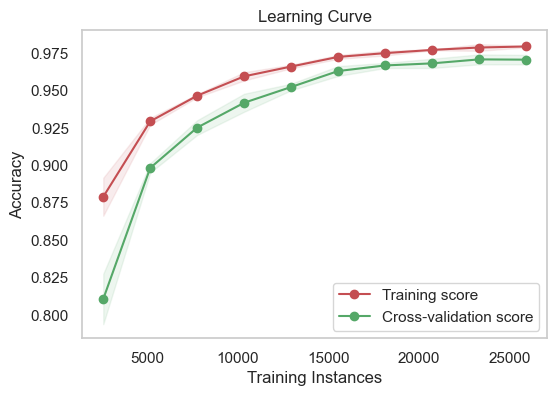

In [22]:
plot_learning_curve(dt_tuned_model, risk_factors_train, target_train, 5, scoring='accuracy')

In [55]:
# Cross-validation
# Perform cross-validation with train and test scores
cv_results = cross_validate(dt_tuned_model, x, y, cv=5, return_train_score=True)

# Print cross-validation results
print("Train Accuracy:", cv_results['train_score'])
print("Mean Train Accuracy:", cv_results['train_score'].mean())
print("Test Accuracy:", cv_results['test_score'])
print("Mean Test Accuracy:", cv_results['test_score'].mean())

Train Accuracy: [0.97758706 0.97968634 0.97959373 0.98227958 0.98453322]
Mean Train Accuracy: 0.9807359841936281
Test Accuracy: [0.96925167 0.9796246  0.96542356 0.9728328  0.98604594]
Mean Test Accuracy: 0.9746357125216104


In [56]:
metrics_df.loc[metrics_df['Model'] == 'DT', 'Accuracy'] = cv_results['test_score'].mean()
print(metrics_df)

  Model  Accuracy  Precision    Recall  F1 Score  Specificity
0    DT  0.974636    0.97562  0.975586  0.975549     0.968297


C:\Users\tsfat\AppData\Local\Temp\ipykernel_17388\280330674.py:21: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='Importance', y='Feature', data=feature_importance_df, palette='viridis', ci=None)
C:\Users\tsfat\AppData\Local\Temp\ipykernel_17388\280330674.py:21: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Importance', y='Feature', data=feature_importance_df, palette='viridis', ci=None)


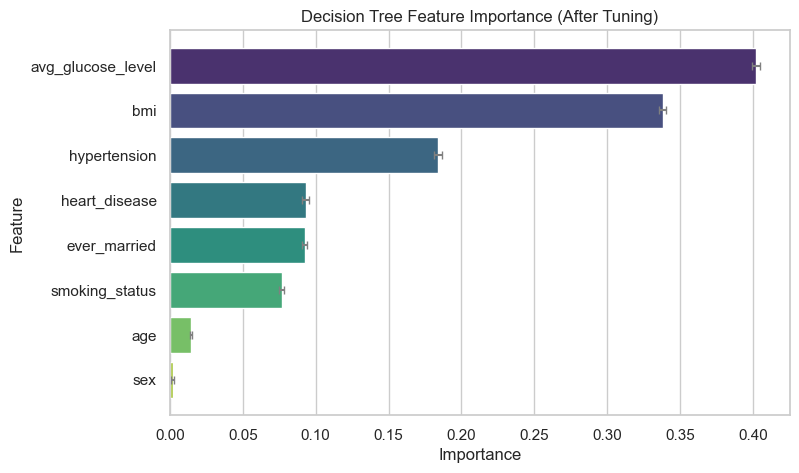

In [25]:
plot_permutation_importance(dt_tuned_model, risk_factors_test, target_test, x.columns, 
                            title='Decision Tree Feature Importance (After Tuning)', scoring='accuracy')

SHAP values shape: (8098, 8, 2)
Risk factors test shape: (8098, 8)


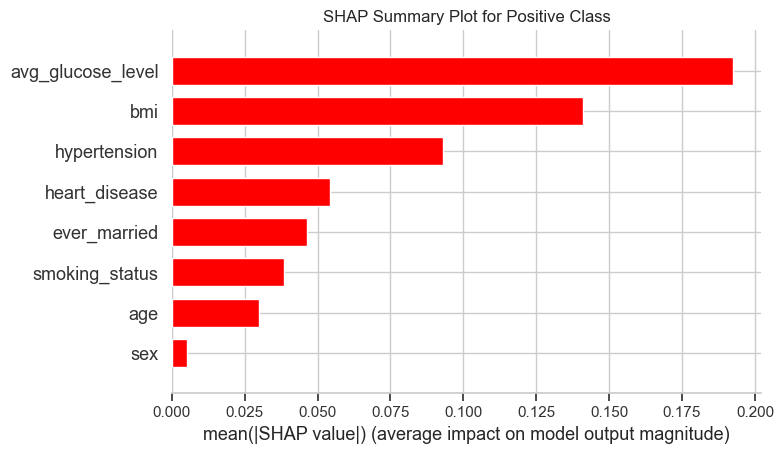

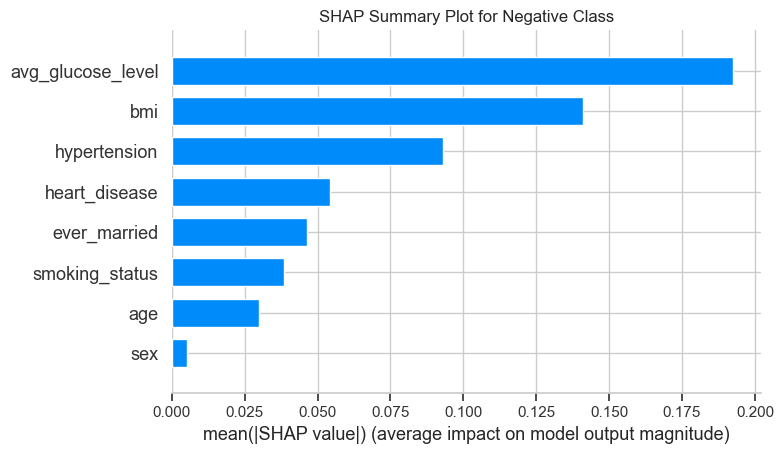

In [87]:
import shap

# Initialize the SHAP TreeExplainer
explainer = shap.TreeExplainer(dt_tuned_model)

# Calculate SHAP values for the test data
shap_values = explainer.shap_values(risk_factors_test)

# Print the shape of SHAP values and risk_factors_test to ensure they match
print("SHAP values shape:", shap_values.shape)
print("Risk factors test shape:", risk_factors_test.shape)

positive_shap_values = shap_values[:, :, 1]  # Select the SHAP values for the positive class
negative_shap_values = shap_values[:, :, 0]  # Negative class
# shap.summary_plot(reshaped_shap_values, risk_factors_test, feature_names=x.columns)

# Plot SHAP summary plot for the positive class
plt.figure(figsize=(10, 6))  # Set the figure size
shap.summary_plot(positive_shap_values, risk_factors_test, feature_names=x.columns, plot_type="bar", color='red', show=False)
plt.title("SHAP Summary Plot for Positive Class")
plt.tight_layout()  # Adjust layout to make room for the title
plt.show()

# Plot SHAP summary plot for the negative class
plt.figure(figsize=(10, 6))  # Set the figure size
shap.summary_plot(negative_shap_values, risk_factors_test, feature_names=x.columns, plot_type="bar", show=False)
plt.title("SHAP Summary Plot for Negative Class")
plt.tight_layout()  # Adjust layout to make room for the title
plt.show()

In [58]:
exp = explain_stroke_instance(risk_factors_train, risk_factors_test, target_test, dt_tuned_model, x, 1)

Original Values:    sex   age  hypertension  heart_disease  ever_married  avg_glucose_level  \
0  0.0  38.0           1.0            0.0           1.0             233.29   

    bmi  smoking_status  
0  48.9             0.0  


In [28]:
exp = explain_stroke_instance(risk_factors_train, risk_factors_test, target_test, dt_tuned_model, x, 0)

Original Values:    sex   age  hypertension  heart_disease  ever_married  avg_glucose_level  \
0  1.0  14.0           0.0            0.0           0.0              69.21   

    bmi  smoking_status  
0  33.1             0.0  


Feature removed: sex
Training Accuracy: 0.9830
Testing Accuracy: 0.9758

Feature removed: age
Training Accuracy: 0.9851
Testing Accuracy: 0.9785

Feature removed: hypertension
Training Accuracy: 0.9812
Testing Accuracy: 0.9686

Feature removed: heart_disease
Training Accuracy: 0.9817
Testing Accuracy: 0.9751

Feature removed: ever_married
Training Accuracy: 0.9885
Testing Accuracy: 0.9838

Feature removed: avg_glucose_level
Training Accuracy: 0.9277
Testing Accuracy: 0.9063

Feature removed: bmi
Training Accuracy: 0.9751
Testing Accuracy: 0.9694

Feature removed: smoking_status
Training Accuracy: 0.9844
Testing Accuracy: 0.9762



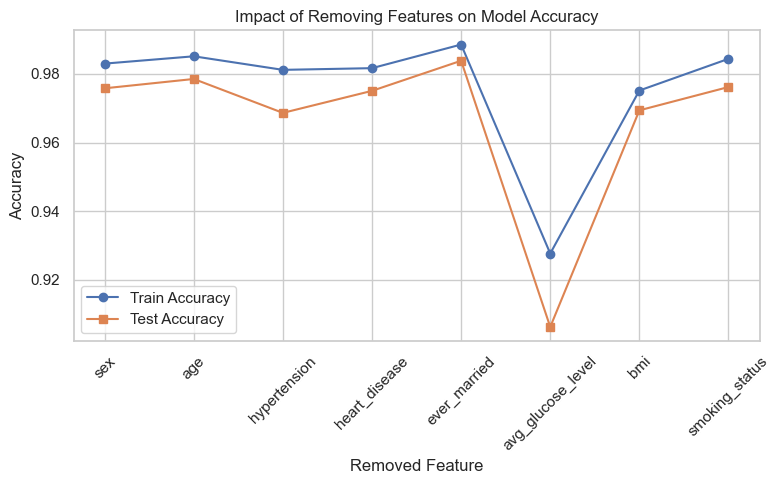

In [29]:
evaluate_feature_impact(x, risk_factors_train, risk_factors_test, target_train, target_test, dt_tuned_model)

#### Logistic Regression (LR)

##### Before Hyperparameter Tuning

Before Hyperparamater Tuning: 
Training Accuracy:  0.6782538898493455
Testing Accuracy:  0.6743640405038281
Specificity (True Negative Rate):  0.759646104694028

Classification Report: 
               precision    recall  f1-score   support

   No Stroke     0.6507    0.7596    0.7010      4069
      Stroke     0.7079    0.5882    0.6425      4029

    accuracy                         0.6744      8098
   macro avg     0.6793    0.6739    0.6718      8098
weighted avg     0.6792    0.6744    0.6719      8098



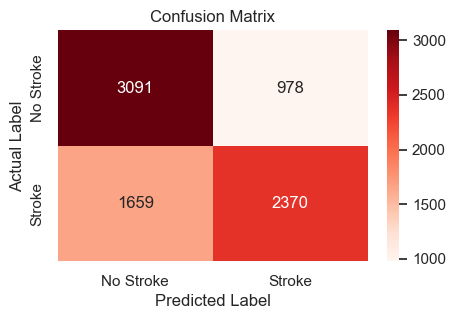

In [93]:
# Initialize the LR model
lr_model = LogisticRegression(max_iter=1000, random_state=42)

# Train the model with training data
lr_model.fit(risk_factors_train, target_train)

# Test the model with training and testing data
lr_target_pred_train = lr_model.predict(risk_factors_train)
lr_target_pred_test = lr_model.predict(risk_factors_test)

# Calculate accuracy
lr_train_accuracy = accuracy_score(target_train, lr_target_pred_train)
lr_test_accuracy = accuracy_score(target_test, lr_target_pred_test)
test_conf_matrix = confusion_matrix(target_test, lr_target_pred_test)
tn, fp, fn, tp = test_conf_matrix.ravel()
specificity = tn / (tn + fp)

# Classification report
lr_test_report = classification_report(target_test, lr_target_pred_test, target_names=target_names, digits=4)

print("Before Hyperparamater Tuning: ")
print("Training Accuracy: ", lr_train_accuracy)
print("Testing Accuracy: ", lr_test_accuracy)
print("Specificity (True Negative Rate): ", specificity)
print("\nClassification Report: \n", lr_test_report)

# Confusion Matrix
test_conf_matrix = confusion_matrix(target_test, lr_target_pred_test)
plt.figure(figsize=(5, 3))
sns.heatmap(test_conf_matrix, annot=True, cmap='Reds', fmt='d', xticklabels=target_names, yticklabels=target_names)
plt.xlabel('Predicted Label')
plt.ylabel('Actual Label')
plt.title('Confusion Matrix')
plt.show()

<module 'matplotlib.pyplot' from 'c:\\Users\\tanky\\AppData\\Local\\Programs\\Python\\Python312\\Lib\\site-packages\\matplotlib\\pyplot.py'>

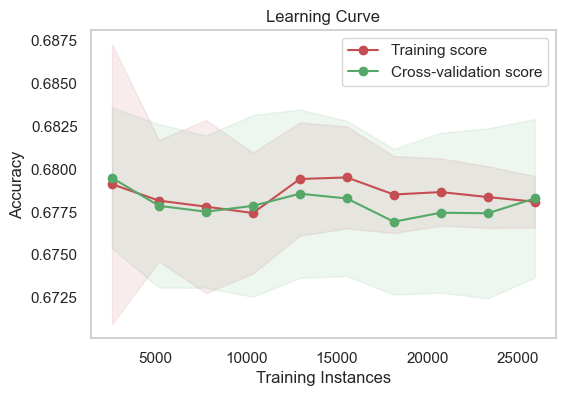

In [94]:
plot_learning_curve(lr_model, risk_factors_train, target_train, 5, scoring='accuracy')

C:\Users\tanky\AppData\Local\Temp\ipykernel_17332\280330674.py:21: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='Importance', y='Feature', data=feature_importance_df, palette='viridis', ci=None)
C:\Users\tanky\AppData\Local\Temp\ipykernel_17332\280330674.py:21: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Importance', y='Feature', data=feature_importance_df, palette='viridis', ci=None)


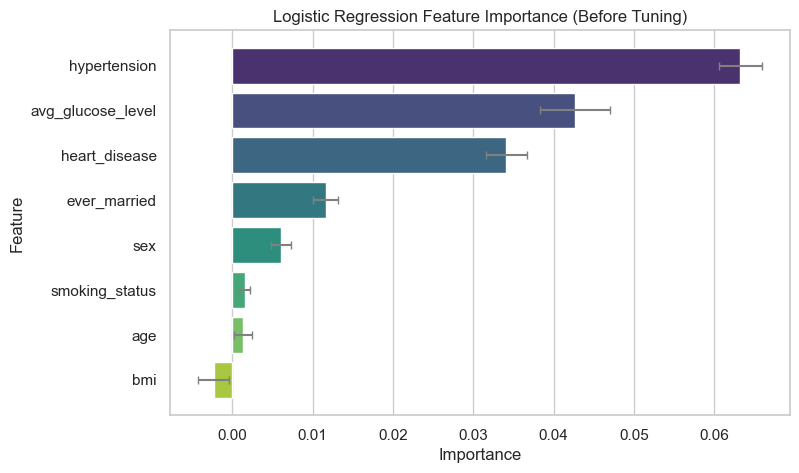

In [95]:
plot_permutation_importance(lr_model, risk_factors_test, target_test, x.columns, 
                            title='Logistic Regression Feature Importance (Before Tuning)', scoring='accuracy')

##### Hyperparameter Tuning

In [34]:
# Hyperparameter tuning
lr_param_grid = {
    'C': np.logspace(-6, 4, 50), 
    'penalty': ['l1', 'l2'], 
    'solver': ['liblinear', 'saga'],  
    'class_weight': [None, 'balanced'], 
    'max_iter': [100, 200, 300, 500],  
    'tol': [1e-2]
}

lr_grid_search = GridSearchCV(lr_model, lr_param_grid, cv=5, refit = True, n_jobs=-1, verbose=1)

lr_grid_search.fit(risk_factors_train, target_train)

print("Best Hyperparameters:", lr_grid_search.best_params_)
print("Best Mean Cross-validated Score:", lr_grid_search.best_score_)

Fitting 5 folds for each of 1600 candidates, totalling 8000 fits
Best Hyperparameters: {'C': 0.0011513953993264481, 'class_weight': None, 'max_iter': 200, 'penalty': 'l1', 'solver': 'liblinear', 'tol': 0.01}
Best Mean Cross-validated Score: 0.6843356175634001


##### After Hyperparameter Tuning

After Hyperparamater Tuning: 
Training Accuracy:  0.6835638429241788
Testing Accuracy:  0.6797974808594714
Specificity (True Negative Rate):  0.7699680511182109

Classification Report: 
               precision    recall  f1-score   support

   No Stroke     0.6541    0.7700    0.7073      4069
      Stroke     0.7170    0.5887    0.6466      4029

    accuracy                         0.6798      8098
   macro avg     0.6856    0.6793    0.6769      8098
weighted avg     0.6854    0.6798    0.6771      8098



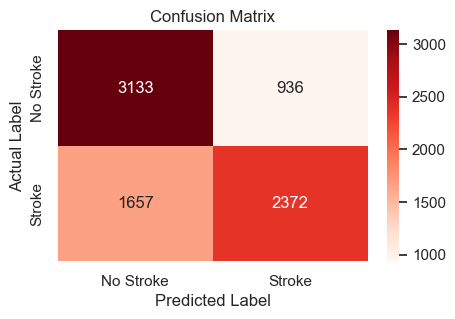

In [57]:
# Best hyperparameters obtained from grid search
lr_best_params = {'C': 0.0011513953993264481, 
               'penalty': 'l1', 
               'solver': 'liblinear', 
               'class_weight': None, 
               'max_iter': 200,
               'tol': 0.01}

# Initialize a new LR model with the best hyperparameters
lr_tuned_model = LogisticRegression(**lr_best_params, random_state=42)

# Train the model with training data
lr_tuned_model.fit(risk_factors_train, target_train)

# Test the model with training and testing data
lr_target_pred_train = lr_tuned_model.predict(risk_factors_train)
lr_target_pred_test = lr_tuned_model.predict(risk_factors_test)

# Calculate accuracy
lr_train_accuracy = accuracy_score(target_train, lr_target_pred_train)
lr_test_accuracy = accuracy_score(target_test, lr_target_pred_test)
test_conf_matrix = confusion_matrix(target_test, lr_target_pred_test)
tn, fp, fn, tp = test_conf_matrix.ravel()
specificity = tn / (tn + fp)

# Calculate precision, recall, F1-score
precision = precision_score(target_test, lr_target_pred_test, average='macro')
recall = recall_score(target_test, lr_target_pred_test, average='macro')
f1 = f1_score(target_test, lr_target_pred_test, average='macro')

# Classification report
lr_test_report = classification_report(target_test, lr_target_pred_test, target_names=target_names, digits=4)

print("After Hyperparamater Tuning: ")
print("Training Accuracy: ", lr_train_accuracy)
print("Testing Accuracy: ", lr_test_accuracy)
print("Specificity (True Negative Rate): ", specificity)
print("\nClassification Report: \n", lr_test_report)

# Confusion Matrix
test_conf_matrix = confusion_matrix(target_test, lr_target_pred_test)
plt.figure(figsize=(5, 3))
sns.heatmap(test_conf_matrix, annot=True, cmap='Reds', fmt='d', xticklabels=target_names, yticklabels=target_names)
plt.xlabel('Predicted Label')
plt.ylabel('Actual Label')
plt.title('Confusion Matrix')
plt.show()

In [58]:
# Append the Logistic Regression model's metrics
new_row = pd.DataFrame({
    'Model': ['LR'],
    'Accuracy': [None],
    'Specificity': [specificity],
    'Precision': [precision],
    'Recall': [recall],
    'F1 Score': [f1]
})

metrics_df = pd.concat([metrics_df, new_row], ignore_index=True)

print("Model Evaluation Metrics without Accuracy:")
print(metrics_df)

Model Evaluation Metrics without Accuracy:
  Model  Accuracy  Precision    Recall  F1 Score  Specificity
0    DT  0.974636    0.97562  0.975586  0.975549     0.968297
1    LR      None    0.68556  0.679350  0.676945     0.769968


<module 'matplotlib.pyplot' from 'c:\\Users\\tsfat\\AppData\\Local\\Programs\\Python\\Python312\\Lib\\site-packages\\matplotlib\\pyplot.py'>

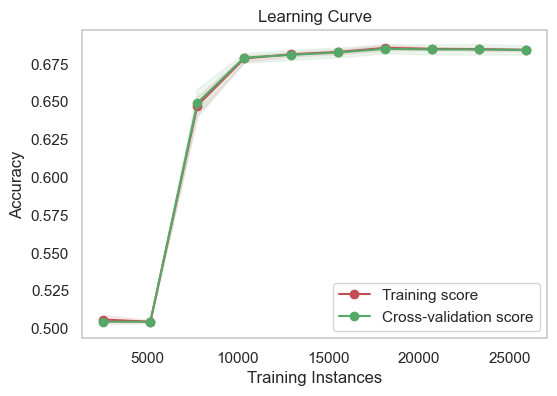

In [36]:
plot_learning_curve(lr_tuned_model, risk_factors_train, target_train, 5, scoring='accuracy')

In [59]:
# Cross-validation
# Perform cross-validation with train and test scores
cv_results = cross_validate(lr_tuned_model, x, y, cv=5, return_train_score=True)

# Print cross-validation results
print("Train Accuracy:", cv_results['train_score'])
print("Mean Train Accuracy:", cv_results['train_score'].mean())
print("Test Accuracy:", cv_results['test_score'])
print("Mean Test Accuracy:", cv_results['test_score'].mean())

Train Accuracy: [0.65491479 0.65794023 0.65621141 0.66056434 0.65827982]
Mean Train Accuracy: 0.6575821190417387
Test Accuracy: [0.64608545 0.65719931 0.61089158 0.63262534 0.65460608]
Mean Test Accuracy: 0.640281551000247


In [60]:
metrics_df.loc[metrics_df['Model'] == 'LR', 'Accuracy'] = cv_results['test_score'].mean()
print(metrics_df)

  Model  Accuracy  Precision    Recall  F1 Score  Specificity
0    DT  0.974636    0.97562  0.975586  0.975549     0.968297
1    LR  0.640282    0.68556  0.679350  0.676945     0.769968


C:\Users\tsfat\AppData\Local\Temp\ipykernel_17388\280330674.py:21: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='Importance', y='Feature', data=feature_importance_df, palette='viridis', ci=None)
C:\Users\tsfat\AppData\Local\Temp\ipykernel_17388\280330674.py:21: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Importance', y='Feature', data=feature_importance_df, palette='viridis', ci=None)


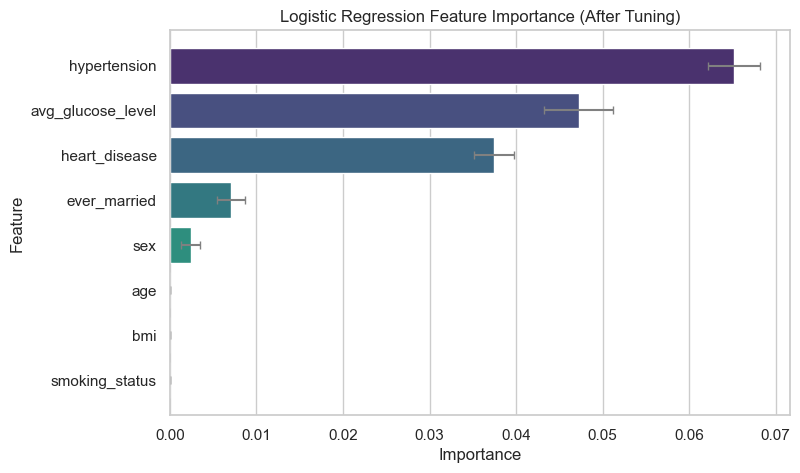

In [39]:
plot_permutation_importance(lr_tuned_model, risk_factors_test, target_test, x.columns, 
                            title='Logistic Regression Feature Importance (After Tuning)', scoring='accuracy')

#### Gradient Boosting (GB)

##### Before Hyperparameter Tuning

Before Hyperparamater Tuning: 
Training Accuracy:  0.8029451716473204
Testing Accuracy:  0.7941467028896023
Specificity (True Negative Rate):  0.8215777832391251

Classification Report: 
               precision    recall  f1-score   support

   No Stroke     0.7803    0.8216    0.8004      4069
      Stroke     0.8096    0.7664    0.7875      4029

    accuracy                         0.7941      8098
   macro avg     0.7950    0.7940    0.7939      8098
weighted avg     0.7949    0.7941    0.7940      8098



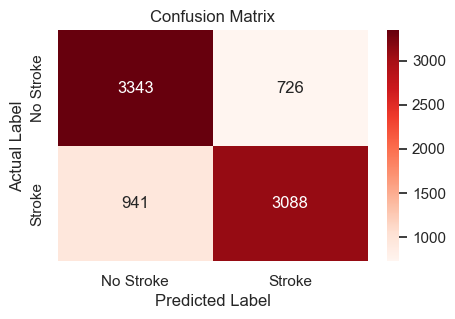

In [17]:
# Initialize the GB model
gb_model = GradientBoostingClassifier(random_state=42)

# Train the model with training data
gb_model.fit(risk_factors_train, target_train)

# Test the model with training and testing data
gb_target_pred_train = gb_model.predict(risk_factors_train)
gb_target_pred_test = gb_model.predict(risk_factors_test)

# Calculate accuracy
gb_train_accuracy = accuracy_score(target_train, gb_target_pred_train)
gb_test_accuracy = accuracy_score(target_test, gb_target_pred_test)
test_conf_matrix = confusion_matrix(target_test, gb_target_pred_test)
tn, fp, fn, tp = test_conf_matrix.ravel()
specificity = tn / (tn + fp)

# Classification report
gb_test_report = classification_report(target_test, gb_target_pred_test, target_names=target_names, digits=4)

print("Before Hyperparamater Tuning: ")
print("Training Accuracy: ", gb_train_accuracy)
print("Testing Accuracy: ", gb_test_accuracy)
print("Specificity (True Negative Rate): ", specificity)
print("\nClassification Report: \n", gb_test_report)

# Confusion Matrix
test_conf_matrix = confusion_matrix(target_test, gb_target_pred_test)
plt.figure(figsize=(5, 3))
sns.heatmap(test_conf_matrix, annot=True, cmap='Reds', fmt='d', xticklabels=target_names, yticklabels=target_names)
plt.xlabel('Predicted Label')
plt.ylabel('Actual Label')
plt.title('Confusion Matrix')
plt.show()

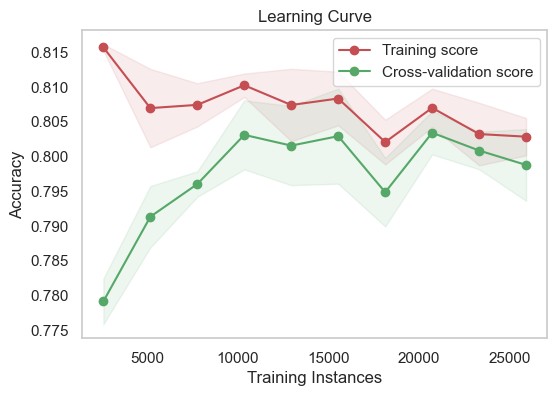

In [99]:
plot_learning_curve(gb_model, risk_factors_train, target_train, 5, scoring='accuracy')
plt.show()

C:\Users\tanky\AppData\Local\Temp\ipykernel_17332\280330674.py:21: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='Importance', y='Feature', data=feature_importance_df, palette='viridis', ci=None)
C:\Users\tanky\AppData\Local\Temp\ipykernel_17332\280330674.py:21: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Importance', y='Feature', data=feature_importance_df, palette='viridis', ci=None)


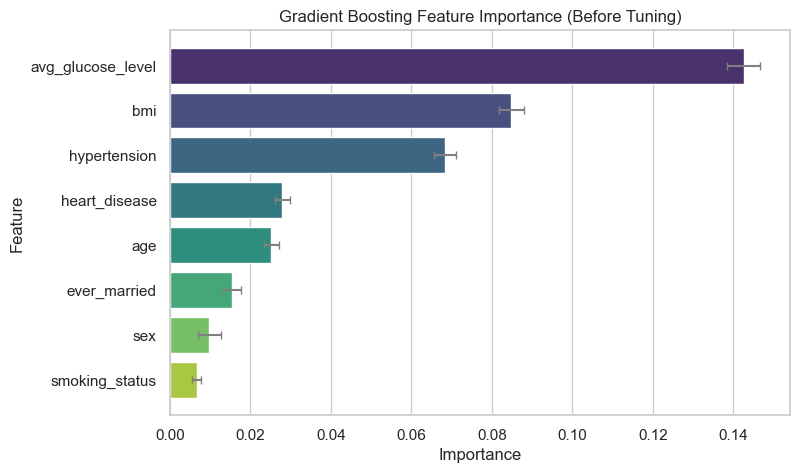

In [100]:
plot_permutation_importance(gb_model, risk_factors_test, target_test, x.columns, 
                            title='Gradient Boosting Feature Importance (Before Tuning)', scoring='accuracy')

##### Hyperparameter Tuning

In [44]:
gb_param_grid = {
    'learning_rate': [0.01, 0.02],  
    'n_estimators': [100, 200, 500],      
    'max_depth': [3, 5],             
    'min_samples_leaf': [2, 4],      
    'max_features': ['sqrt', 'log2', 0.5],  
    'subsample': [0.7, 0.8, 0.9]      
}
# Use grid search to find the best hyperparameters
gb_grid_search = GridSearchCV(gb_model, gb_param_grid, cv=5, refit = True, n_jobs=-1, verbose=1)
                           
gb_grid_search.fit(risk_factors_train, target_train)

print("Best Hyperparameters:", gb_grid_search.best_params_)
print("Best Mean Cross-validated Score:", gb_grid_search.best_score_)

Fitting 5 folds for each of 216 candidates, totalling 1080 fits
Best Hyperparameters: {'learning_rate': 0.02, 'max_depth': 5, 'max_features': 0.5, 'min_samples_leaf': 2, 'n_estimators': 500, 'subsample': 0.7}
Best Mean Cross-validated Score: 0.9136515431788291


##### After Hyperparameter Tuning

Before Hyperparamater Tuning: 
Training Accuracy:  0.9165534699925908
Testing Accuracy:  0.9098542850086441
Specificity (True Negative Rate):  0.9014499877119685

Classification Report: 
               precision    recall  f1-score   support

   No Stroke     0.9177    0.9014    0.9095      4069
      Stroke     0.9022    0.9183    0.9102      4029

    accuracy                         0.9099      8098
   macro avg     0.9100    0.9099    0.9099      8098
weighted avg     0.9100    0.9099    0.9099      8098



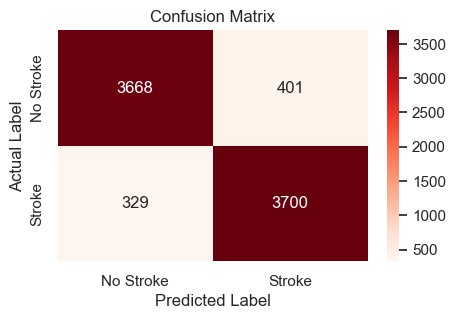

In [20]:
# Best hyperparameters obtained from grid search
gb_best_params = {'learning_rate': 0.02, 
               'n_estimators': 500, 
               'max_depth': 5, 
               'min_samples_leaf': 2, 
               'max_features': 0.5,
               'subsample': 0.7}

# Initialize a new GB model with the best hyperparameters
gb_tuned_model = GradientBoostingClassifier(**gb_best_params, random_state=42)

# Train the model with training data
gb_tuned_model.fit(risk_factors_train, target_train)

# Test the model with training and testing data
gb_target_pred_train = gb_tuned_model.predict(risk_factors_train)
gb_target_pred_test = gb_tuned_model.predict(risk_factors_test)

# Calculate accuracy
gb_train_accuracy = accuracy_score(target_train, gb_target_pred_train)
gb_test_accuracy = accuracy_score(target_test, gb_target_pred_test)
test_conf_matrix = confusion_matrix(target_test, gb_target_pred_test)
tn, fp, fn, tp = test_conf_matrix.ravel()
specificity = tn / (tn + fp)

# Calculate precision, recall, F1-score
precision = precision_score(target_test, gb_target_pred_test, average='macro')
recall = recall_score(target_test, gb_target_pred_test, average='macro')
f1 = f1_score(target_test, gb_target_pred_test, average='macro')

# Classification report
gb_test_report = classification_report(target_test, gb_target_pred_test, target_names=target_names, digits=4)

print("Before Hyperparamater Tuning: ")
print("Training Accuracy: ", gb_train_accuracy)
print("Testing Accuracy: ", gb_test_accuracy)
print("Specificity (True Negative Rate): ", specificity)
print("\nClassification Report: \n", gb_test_report)

# Confusion Matrix
test_conf_matrix = confusion_matrix(target_test, gb_target_pred_test)
plt.figure(figsize=(5, 3))
sns.heatmap(test_conf_matrix, annot=True, cmap='Reds', fmt='d', xticklabels=target_names, yticklabels=target_names)
plt.xlabel('Predicted Label')
plt.ylabel('Actual Label')
plt.title('Confusion Matrix')
plt.show()

In [62]:
# Append the Gradient Boosting model's metrics
new_row = pd.DataFrame({
    'Model': ['GB'],
    'Accuracy': [None],
    'Specificity': [specificity],
    'Precision': [precision],
    'Recall': [recall],
    'F1 Score': [f1]
})

metrics_df = pd.concat([metrics_df, new_row], ignore_index=True)

print("Model Evaluation Metrics without Accuracy:")
print(metrics_df)

Model Evaluation Metrics without Accuracy:
  Model  Accuracy  Precision    Recall  F1 Score  Specificity
0    DT  0.974636   0.975620  0.975586  0.975549     0.968297
1    LR  0.640282   0.685560  0.679350  0.676945     0.769968
2    GB      None   0.909954  0.909896  0.909853     0.901450


<module 'matplotlib.pyplot' from 'c:\\Users\\tanky\\AppData\\Local\\Programs\\Python\\Python312\\Lib\\site-packages\\matplotlib\\pyplot.py'>

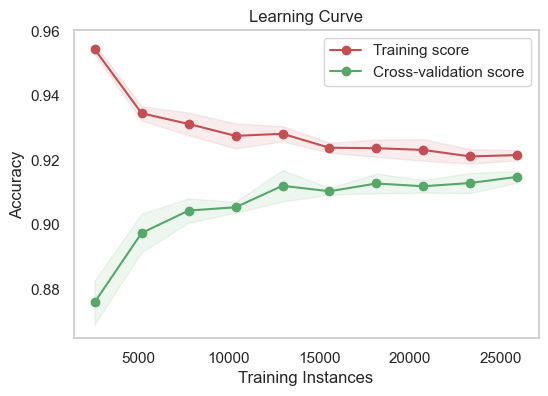

In [102]:
plot_learning_curve(gb_tuned_model, risk_factors_train, target_train, 5, scoring='accuracy')

In [35]:
# Cross-validation
# Perform cross-validation with train and test scores
gb_cv_results = cross_validate(gb_tuned_model, x, y, cv=5, return_train_score=True)

# Print cross-validation results
print("Train Accuracy:", gb_cv_results['train_score'])
print("Mean Train Accuracy:", gb_cv_results['train_score'].mean())
print("Test Accuracy:", gb_cv_results['test_score'])
print("Mean Test Accuracy:", gb_cv_results['test_score'].mean())

Train Accuracy: [0.91278711 0.9167387  0.91840578 0.91343542 0.92612373]
Mean Train Accuracy: 0.9174981476907877
Test Accuracy: [0.89293653 0.91392937 0.8999753  0.91269449 0.92985922]
Mean Test Accuracy: 0.9098789824648061


In [63]:
metrics_df.loc[metrics_df['Model'] == 'GB', 'Accuracy'] = gb_cv_results['test_score'].mean()
print(metrics_df)

  Model  Accuracy  Precision    Recall  F1 Score  Specificity
0    DT  0.974636   0.975620  0.975586  0.975549     0.968297
1    LR  0.640282   0.685560  0.679350  0.676945     0.769968
2    GB  0.909879   0.909954  0.909896  0.909853     0.901450


C:\Users\tsfat\AppData\Local\Temp\ipykernel_17388\280330674.py:21: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='Importance', y='Feature', data=feature_importance_df, palette='viridis', ci=None)
C:\Users\tsfat\AppData\Local\Temp\ipykernel_17388\280330674.py:21: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Importance', y='Feature', data=feature_importance_df, palette='viridis', ci=None)


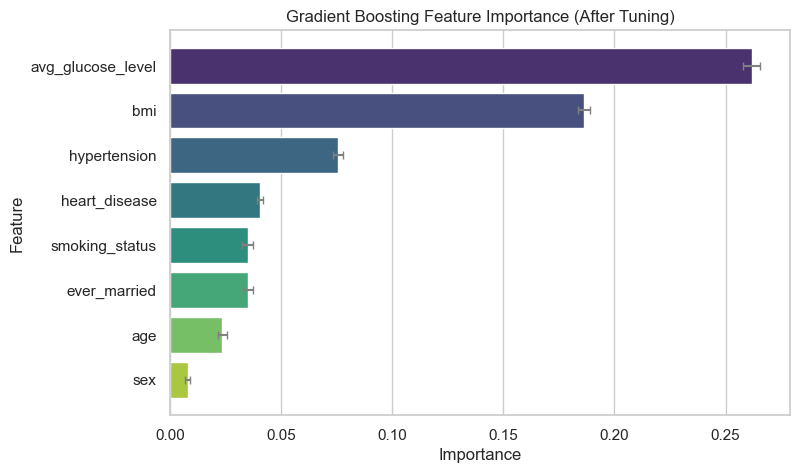

In [49]:
plot_permutation_importance(gb_tuned_model, risk_factors_test, target_test, x.columns, 
                            title='Gradient Boosting Feature Importance (After Tuning)', scoring='accuracy')

SHAP values shape: [(8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8

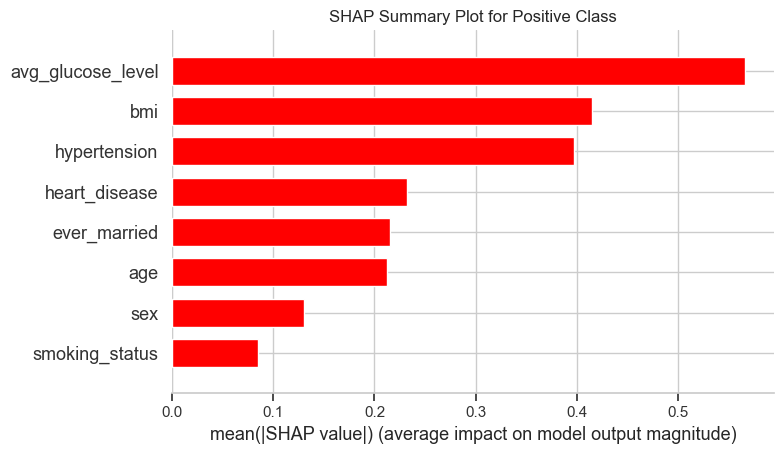

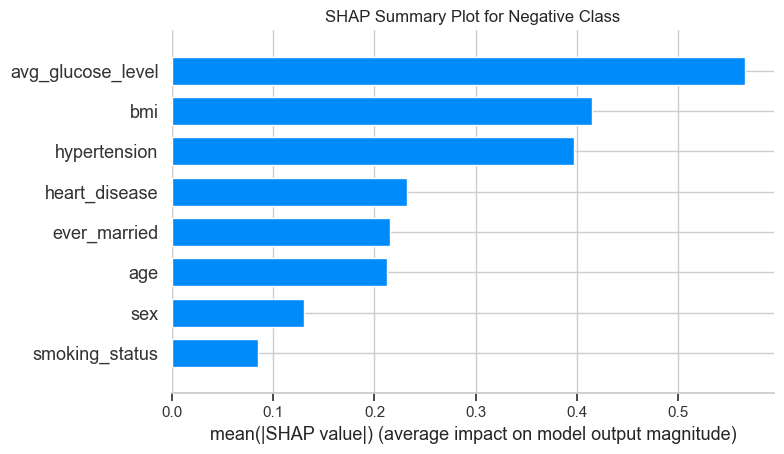

In [125]:
import shap

# risk_factors_train_df = pd.DataFrame(risk_factors_train, columns=x.columns)
# risk_factors_test_df = pd.DataFrame(risk_factors_test, columns=x.columns)

# Initialize the SHAP TreeExplainer
explainer = shap.TreeExplainer(gb_tuned_model)

# Calculate SHAP values for the test data
shap_values = explainer.shap_values(risk_factors_test)

# Print the shape of SHAP values and risk_factors_test to ensure they match
print("SHAP values shape:", [sv.shape for sv in shap_values])  # shap_values is a list
print("Risk factors test shape:", risk_factors_test.shape)

# If shap_values is a list with two elements, we can assume it's for binary classification
if isinstance(shap_values, list) and len(shap_values) == 2:
    positive_shap_values = shap_values[1]  # Select the SHAP values for the positive class
    negative_shap_values = shap_values[0]  # Negative class
elif isinstance(shap_values, np.ndarray) and shap_values.ndim == 2:
    # Assuming the output is already the SHAP values for the positive class
    positive_shap_values = shap_values
    negative_shap_values = -shap_values  # Invert the SHAP values for the negative class
else:
    raise ValueError("Unexpected structure of shap_values")

# Plot SHAP summary plot for the positive class
plt.figure(figsize=(10, 6))  # Set the figure size
shap.summary_plot(positive_shap_values, risk_factors_test, feature_names=x.columns, plot_type="bar", color='red', show=False)
plt.title("SHAP Summary Plot for Positive Class")
plt.tight_layout()  # Adjust layout to make room for the title
plt.show()

# Plot SHAP summary plot for the negative class
plt.figure(figsize=(10, 6))  # Set the figure size
shap.summary_plot(negative_shap_values, risk_factors_test, feature_names=x.columns, plot_type="bar", show=False)
plt.title("SHAP Summary Plot for Negative Class")
plt.tight_layout()  # Adjust layout to make room for the title
plt.show()

In [14]:
exp = explain_stroke_instance(risk_factors_train, risk_factors_test, target_test, gb_tuned_model, x, 1)

Original Values:    sex   age  hypertension  heart_disease  ever_married  avg_glucose_level  \
0  0.0  35.0           0.0            0.0           1.0             221.89   

    bmi  smoking_status  
0  37.3             1.0  


In [19]:
exp = explain_stroke_instance(risk_factors_train, risk_factors_test, target_test, gb_tuned_model, x, 0)

Original Values:    sex   age  hypertension  heart_disease  ever_married  avg_glucose_level  \
0  1.0  31.0           0.0            1.0           1.0              76.78   

    bmi  smoking_status  
0  22.7             1.0  


#### Random Forest (RF)

##### Before Hyperparameter Tuning

Before Hyperparamater Tuning: 
Training Accuracy:  1.0
Testing Accuracy:  0.9796245986663373
Specificity (True Negative Rate):  0.971983288277218

Classification Report: 
               precision    recall  f1-score   support

   No Stroke     0.9873    0.9720    0.9796      4069
      Stroke     0.9721    0.9873    0.9797      4029

    accuracy                         0.9796      8098
   macro avg     0.9797    0.9797    0.9796      8098
weighted avg     0.9797    0.9796    0.9796      8098



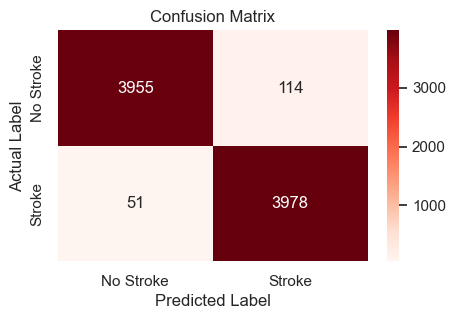

In [19]:
# Initialize the RF model
rf_model = RandomForestClassifier(random_state=42)

# Train the model with training data
rf_model.fit(risk_factors_train, target_train)

# Test the model with training and testing data
rf_target_pred_train = rf_model.predict(risk_factors_train)
rf_target_pred_test = rf_model.predict(risk_factors_test)

# Calculate accuracy
rf_train_accuracy = accuracy_score(target_train, rf_target_pred_train)
rf_test_accuracy = accuracy_score(target_test, rf_target_pred_test)
test_conf_matrix = confusion_matrix(target_test, rf_target_pred_test)
tn, fp, fn, tp = test_conf_matrix.ravel()
specificity = tn / (tn + fp)

# Classification report
rf_test_report = classification_report(target_test, rf_target_pred_test, target_names=target_names, digits=4)

print("Before Hyperparamater Tuning: ")
print("Training Accuracy: ", rf_train_accuracy)
print("Testing Accuracy: ", rf_test_accuracy)
print("Specificity (True Negative Rate): ", specificity)
print("\nClassification Report: \n", rf_test_report)

# Confusion Matrix
test_conf_matrix = confusion_matrix(target_test, rf_target_pred_test)
plt.figure(figsize=(5, 3))
sns.heatmap(test_conf_matrix, annot=True, cmap='Reds', fmt='d', xticklabels=target_names, yticklabels=target_names)
plt.xlabel('Predicted Label')
plt.ylabel('Actual Label')
plt.title('Confusion Matrix')
plt.show()

<module 'matplotlib.pyplot' from 'c:\\Users\\tanky\\AppData\\Local\\Programs\\Python\\Python312\\Lib\\site-packages\\matplotlib\\pyplot.py'>

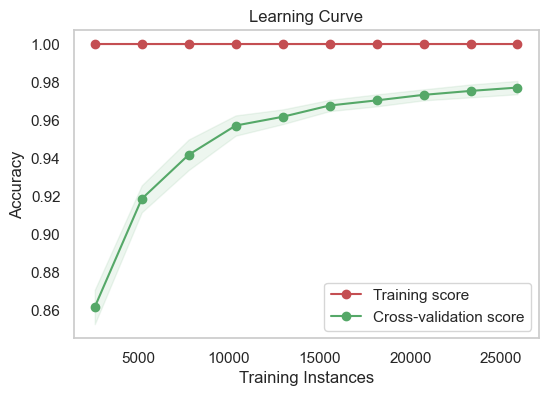

In [112]:
plot_learning_curve(rf_model, risk_factors_train, target_train, 5, scoring='accuracy')

C:\Users\tsfat\AppData\Local\Temp\ipykernel_17388\280330674.py:21: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='Importance', y='Feature', data=feature_importance_df, palette='viridis', ci=None)
C:\Users\tsfat\AppData\Local\Temp\ipykernel_17388\280330674.py:21: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Importance', y='Feature', data=feature_importance_df, palette='viridis', ci=None)


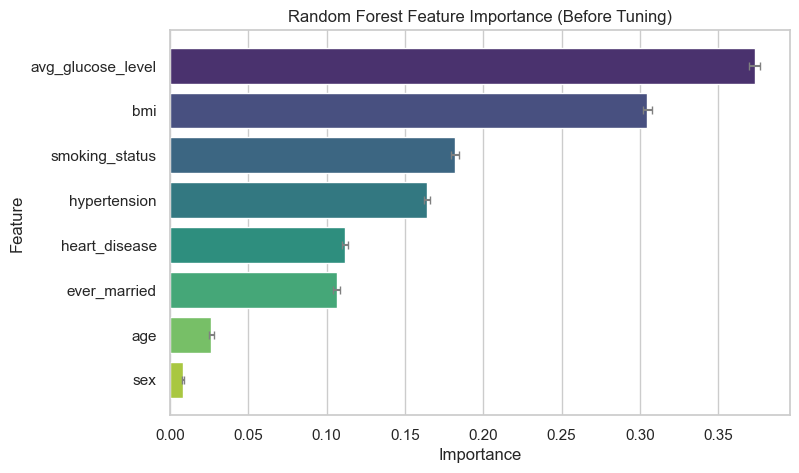

In [56]:
plot_permutation_importance(rf_model, risk_factors_test, target_test, x.columns, 
                            title='Random Forest Feature Importance (Before Tuning)', scoring='accuracy')

Feature removed: sex
Training Accuracy: 1.0000
Testing Accuracy: 0.9853

Feature removed: age
Training Accuracy: 1.0000
Testing Accuracy: 0.9951

Feature removed: hypertension
Training Accuracy: 1.0000
Testing Accuracy: 0.9774

Feature removed: heart_disease
Training Accuracy: 1.0000
Testing Accuracy: 0.9768

Feature removed: ever_married
Training Accuracy: 1.0000
Testing Accuracy: 0.9847

Feature removed: avg_glucose_level
Training Accuracy: 0.9680
Testing Accuracy: 0.8224

Feature removed: bmi
Training Accuracy: 0.9991
Testing Accuracy: 0.8958

Feature removed: smoking_status
Training Accuracy: 1.0000
Testing Accuracy: 0.9743



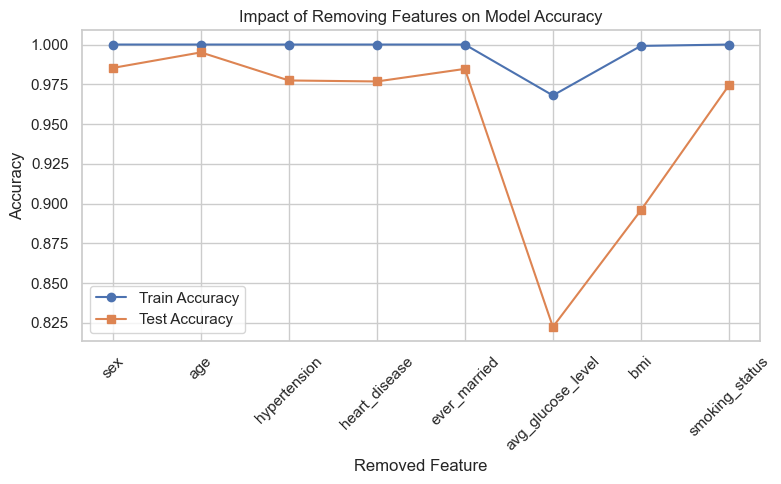

In [17]:
# Evaluate feature impact
evaluate_feature_impact(x, risk_factors_train, risk_factors_test, target_train, target_test, rf_model)

##### Hyperparameter Tuning

In [19]:
# Hyperparameter tuning
rf_param_grid = {
    'n_estimators': [50, 100],  
    'max_depth': [5, 10, 13],        
    'min_samples_split': [6, 8, 10],   
    'min_samples_leaf': [4, 6, 8],    
    'max_features': [0.5, 'sqrt', 0.25], 
    'bootstrap': [True],       
    'criterion': ['gini', 'entropy'],  
}

rf_grid_search = GridSearchCV(rf_model, rf_param_grid, cv=5, refit=True, n_jobs=-1, verbose=1)

rf_grid_search.fit(risk_factors_train, target_train)

print("Best Hyperparameters:", rf_grid_search.best_params_)
print("Best Mean Cross-validated Score:", rf_grid_search.best_score_)

Fitting 5 folds for each of 324 candidates, totalling 1620 fits
Best Hyperparameters: {'bootstrap': True, 'criterion': 'gini', 'max_depth': 13, 'max_features': 0.5, 'min_samples_leaf': 4, 'min_samples_split': 10, 'n_estimators': 100}
Best Mean Cross-validated Score: 0.9396149175708672


##### After Hyperparameter Tuning

After Hyperparamater Tuning: 
Training Accuracy:  0.945881699184984
Testing Accuracy:  0.9317115337120276
Specificity (True Negative Rate):  0.9461784222167609

Classification Report: 
               precision    recall  f1-score   support

   No Stroke     0.9202    0.9462    0.9330      4069
      Stroke     0.9440    0.9171    0.9304      4029

    accuracy                         0.9317      8098
   macro avg     0.9321    0.9316    0.9317      8098
weighted avg     0.9321    0.9317    0.9317      8098



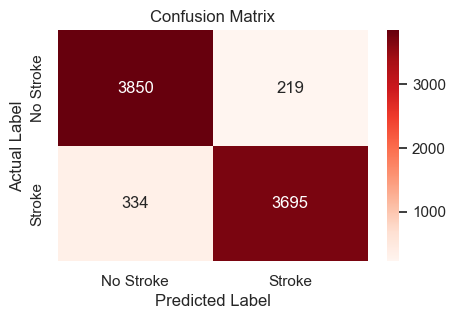

In [21]:
# Best hyperparameters obtained from grid search
rf_best_params = {'n_estimators': 100, 
               'max_depth': 13, 
               'min_samples_split': 10, 
               'min_samples_leaf': 4, 
               'max_features': 0.5,
               'bootstrap': True,
               'criterion': 'gini'}

# Initialize a new RF model with the best hyperparameters
rf_tuned_model = RandomForestClassifier(**rf_best_params, random_state=42)

# Train the model with training data
rf_tuned_model.fit(risk_factors_train, target_train)

# Test the model with training and testing data
rf_target_pred_train = rf_tuned_model.predict(risk_factors_train)
rf_target_pred_test = rf_tuned_model.predict(risk_factors_test)

# Calculate accuracy
rf_train_accuracy = accuracy_score(target_train, rf_target_pred_train)
rf_test_accuracy = accuracy_score(target_test, rf_target_pred_test)
test_conf_matrix = confusion_matrix(target_test, rf_target_pred_test)
tn, fp, fn, tp = test_conf_matrix.ravel()
specificity = tn / (tn + fp)

# Calculate precision, recall, F1-score
precision = precision_score(target_test, rf_target_pred_test, average='macro')
recall = recall_score(target_test, rf_target_pred_test, average='macro')
f1 = f1_score(target_test, rf_target_pred_test, average='macro')

# Classification report
rf_test_report = classification_report(target_test, rf_target_pred_test, target_names=target_names, digits=4)

print("After Hyperparamater Tuning: ")
print("Training Accuracy: ", rf_train_accuracy)
print("Testing Accuracy: ", rf_test_accuracy)
print("Specificity (True Negative Rate): ", specificity)
print("\nClassification Report: \n", rf_test_report)

# Confusion Matrix
test_conf_matrix = confusion_matrix(target_test, rf_target_pred_test)
plt.figure(figsize=(5, 3))
sns.heatmap(test_conf_matrix, annot=True, cmap='Reds', fmt='d', xticklabels=target_names, yticklabels=target_names)
plt.xlabel('Predicted Label')
plt.ylabel('Actual Label')
plt.title('Confusion Matrix')
plt.show()

In [65]:
# Append the Random Forest model's metrics
new_row = pd.DataFrame({
    'Model': ['RF'],
    'Accuracy': [None],
    'Specificity': [specificity],
    'Precision': [precision],
    'Recall': [recall],
    'F1 Score': [f1]
})

metrics_df = pd.concat([metrics_df, new_row], ignore_index=True)

print("Model Evaluation Metrics without Accuracy:")
print(metrics_df)

Model Evaluation Metrics without Accuracy:
  Model  Accuracy  Precision    Recall  F1 Score  Specificity
0    DT  0.974636   0.975620  0.975586  0.975549     0.968297
1    LR  0.640282   0.685560  0.679350  0.676945     0.769968
2    GB  0.909879   0.909954  0.909896  0.909853     0.901450
3    RF      None   0.932110  0.931640  0.931687     0.946178


<module 'matplotlib.pyplot' from 'c:\\Users\\tanky\\AppData\\Local\\Programs\\Python\\Python312\\Lib\\site-packages\\matplotlib\\pyplot.py'>

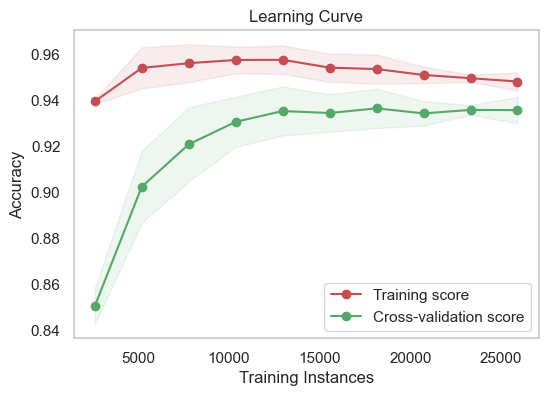

In [114]:
plot_learning_curve(rf_tuned_model, risk_factors_train, target_train, 5, scoring='accuracy')

In [31]:
# Cross-validation
# Perform cross-validation with train and test scores
rf_cv_results = cross_validate(rf_tuned_model, x, y, cv=5, return_train_score=True)

# Print cross-validation results
print("Train Accuracy:", rf_cv_results['train_score'])
print("Mean Train Accuracy:", rf_cv_results['train_score'].mean())
print("Test Accuracy:", rf_cv_results['test_score'])
print("Mean Test Accuracy:", rf_cv_results['test_score'].mean())

Train Accuracy: [0.9402939  0.94628303 0.94798098 0.95452581 0.96329341]
Mean Train Accuracy: 0.9504754260311188
Test Accuracy: [0.90812546 0.93714497 0.92417881 0.94208447 0.96332428]
Mean Test Accuracy: 0.9349715979254137


In [66]:
metrics_df.loc[metrics_df['Model'] == 'RF', 'Accuracy'] = rf_cv_results['test_score'].mean()
print(metrics_df)

  Model  Accuracy  Precision    Recall  F1 Score  Specificity
0    DT  0.974636   0.975620  0.975586  0.975549     0.968297
1    LR  0.640282   0.685560  0.679350  0.676945     0.769968
2    GB  0.909879   0.909954  0.909896  0.909853     0.901450
3    RF  0.934972   0.932110  0.931640  0.931687     0.946178


C:\Users\tsfat\AppData\Local\Temp\ipykernel_17388\280330674.py:21: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='Importance', y='Feature', data=feature_importance_df, palette='viridis', ci=None)
C:\Users\tsfat\AppData\Local\Temp\ipykernel_17388\280330674.py:21: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Importance', y='Feature', data=feature_importance_df, palette='viridis', ci=None)


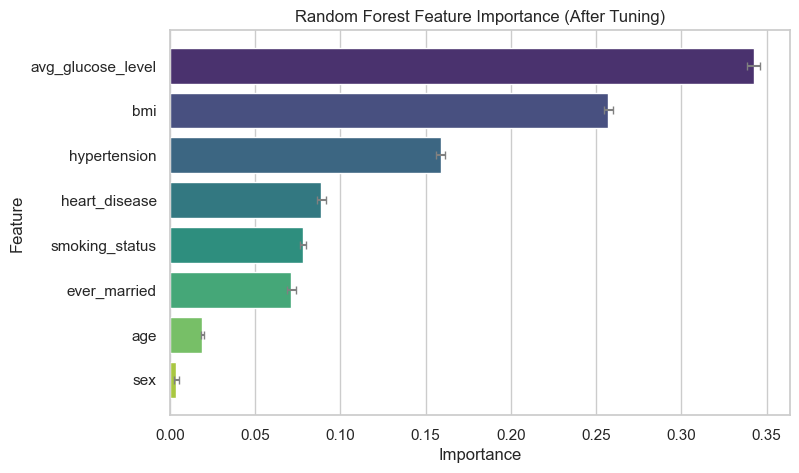

In [87]:
plot_permutation_importance(rf_tuned_model, risk_factors_test, target_test, x.columns, 
                            title='Random Forest Feature Importance (After Tuning)', scoring='accuracy')

Feature removed: sex
Training Accuracy: 0.9562
Testing Accuracy: 0.9441

Feature removed: age
Training Accuracy: 0.9682
Testing Accuracy: 0.9604

Feature removed: hypertension
Training Accuracy: 0.9365
Testing Accuracy: 0.9192

Feature removed: heart_disease
Training Accuracy: 0.9338
Testing Accuracy: 0.9181

Feature removed: ever_married
Training Accuracy: 0.9414
Testing Accuracy: 0.9308

Feature removed: avg_glucose_level
Training Accuracy: 0.8441
Testing Accuracy: 0.8111

Feature removed: bmi
Training Accuracy: 0.8606
Testing Accuracy: 0.8408

Feature removed: smoking_status
Training Accuracy: 0.9352
Testing Accuracy: 0.9184



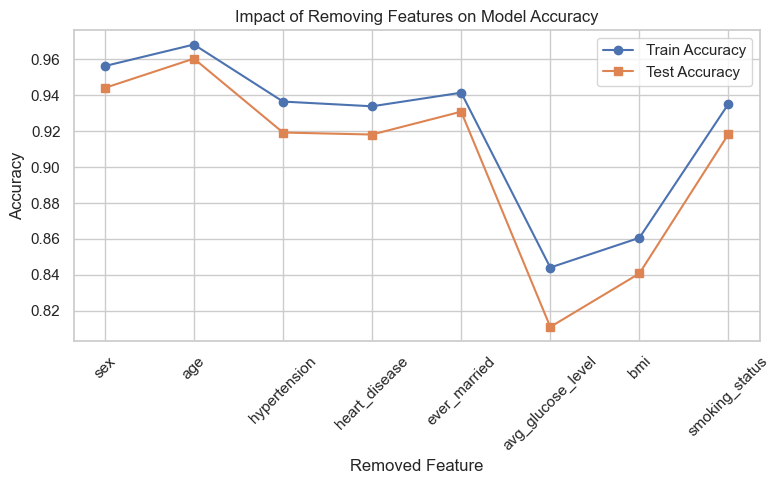

In [18]:
# Evaluate feature impact
evaluate_feature_impact(x, risk_factors_train, risk_factors_test, target_train, target_test, rf_tuned_model)

SHAP values shape: (8098, 8, 2)
Risk factors test shape: (8098, 8)


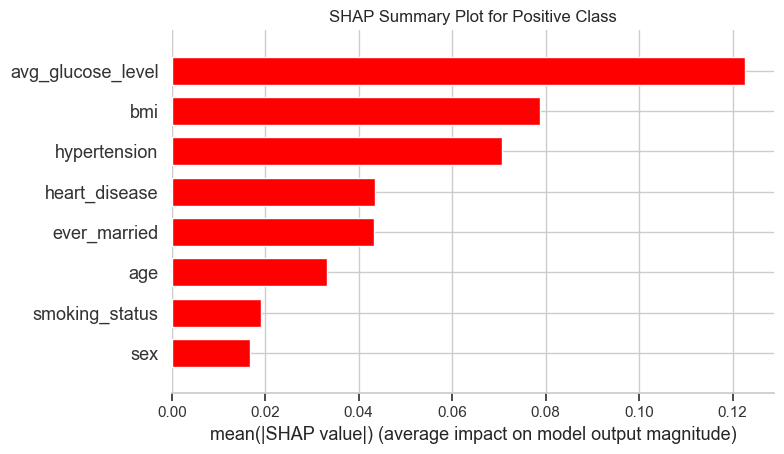

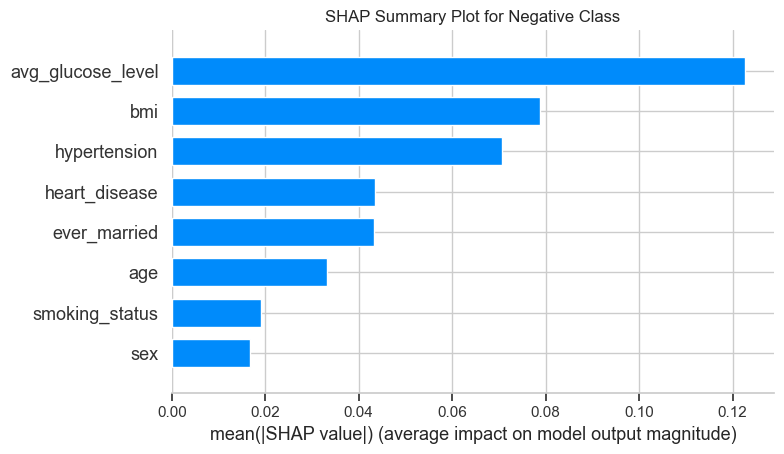

In [116]:
import shap

# Initialize the SHAP TreeExplainer
explainer = shap.TreeExplainer(rf_tuned_model)

# Calculate SHAP values for the test data
shap_values = explainer.shap_values(risk_factors_test)

# Print the shape of SHAP values and risk_factors_test to ensure they match
print("SHAP values shape:", shap_values.shape)
print("Risk factors test shape:", risk_factors_test.shape)

positive_shap_values = shap_values[:, :, 1]  # Select the SHAP values for the positive class
negative_shap_values = shap_values[:, :, 0]  # Negative class
# shap.summary_plot(reshaped_shap_values, risk_factors_test, feature_names=x.columns)

# Plot SHAP summary plot for the positive class
plt.figure(figsize=(10, 6))  # Set the figure size
shap.summary_plot(positive_shap_values, risk_factors_test, feature_names=x.columns, plot_type="bar", color='red', show=False)
plt.title("SHAP Summary Plot for Positive Class")
plt.tight_layout()  # Adjust layout to make room for the title
plt.show()

# Plot SHAP summary plot for the negative class
plt.figure(figsize=(10, 6))  # Set the figure size
shap.summary_plot(negative_shap_values, risk_factors_test, feature_names=x.columns, plot_type="bar", show=False)
plt.title("SHAP Summary Plot for Negative Class")
plt.tight_layout()  # Adjust layout to make room for the title
plt.show()

In [64]:
exp = explain_stroke_instance(risk_factors_train, risk_factors_test, target_test, rf_tuned_model, x, 1)

Original Values:    sex   age  hypertension  heart_disease  ever_married  avg_glucose_level  \
0  0.0  27.0           0.0            0.0           1.0              96.97   

    bmi  smoking_status  
0  29.1             1.0  


In [20]:
exp = explain_stroke_instance(risk_factors_train, risk_factors_test, target_test, rf_tuned_model, x, 0)

Original Values:    sex   age  hypertension  heart_disease  ever_married  avg_glucose_level  \
0  1.0  36.0           1.0            0.0           1.0             125.89   

    bmi  smoking_status  
0  28.9             1.0  


#### Extreme Gradient Boosting (XGBoost)

##### Before Hyperparameter Tuning

Before Hyperparamater Tuning: 
Training Accuracy:  0.989596196591751
Testing Accuracy:  0.9850580390219807
Specificity (True Negative Rate):  0.9744408945686901

Classification Report: 
               precision    recall  f1-score   support

   No Stroke     0.9957    0.9744    0.9850      4069
      Stroke     0.9747    0.9958    0.9851      4029

    accuracy                         0.9851      8098
   macro avg     0.9852    0.9851    0.9851      8098
weighted avg     0.9853    0.9851    0.9851      8098



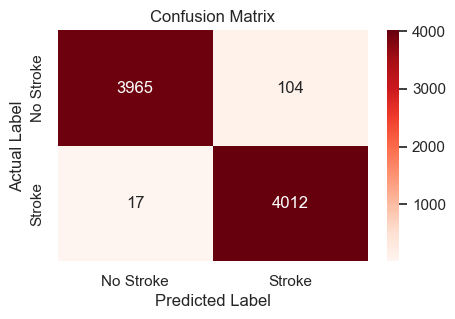

In [21]:
# Initialize the XGB model
xgb_model = XGBClassifier(objective='binary:logistic', n_estimators=80, 
                          seed=42, enable_categorical=True, random_state=42)

# Train the model with training data
xgb_model.fit(risk_factors_train, target_train)

# Test the model with training and testing data
xgb_target_pred_train = xgb_model.predict(risk_factors_train)
xgb_target_pred_test = xgb_model.predict(risk_factors_test)

# Test accuracy
xgb_train_accuracy = accuracy_score(target_train, xgb_target_pred_train)
xgb_test_accuracy = accuracy_score(target_test, xgb_target_pred_test)
test_conf_matrix = confusion_matrix(target_test, xgb_target_pred_test)
tn, fp, fn, tp = test_conf_matrix.ravel()
specificity = tn / (tn + fp)

# Classification report
xgb_test_report = classification_report(target_test, xgb_target_pred_test, target_names=target_names, digits=4)

print("Before Hyperparamater Tuning: ")
print("Training Accuracy: ", xgb_train_accuracy)
print("Testing Accuracy: ", xgb_test_accuracy)
print("Specificity (True Negative Rate): ", specificity)
print("\nClassification Report: \n", xgb_test_report)

# Confusion Matrix
test_conf_matrix = confusion_matrix(target_test, xgb_target_pred_test)
plt.figure(figsize=(5, 3))
sns.heatmap(test_conf_matrix, annot=True, cmap='Reds', fmt='d', xticklabels=target_names, yticklabels=target_names)
plt.xlabel('Predicted Label')
plt.ylabel('Actual Label')
plt.title('Confusion Matrix')
plt.show()

<module 'matplotlib.pyplot' from 'c:\\Users\\tanky\\AppData\\Local\\Programs\\Python\\Python312\\Lib\\site-packages\\matplotlib\\pyplot.py'>

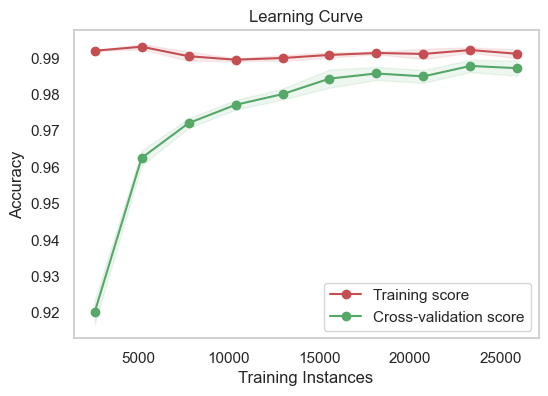

In [118]:
plot_learning_curve(xgb_model, risk_factors_train, target_train, 5, scoring='accuracy')

C:\Users\tsfat\AppData\Local\Temp\ipykernel_17388\280330674.py:21: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='Importance', y='Feature', data=feature_importance_df, palette='viridis', ci=None)
C:\Users\tsfat\AppData\Local\Temp\ipykernel_17388\280330674.py:21: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Importance', y='Feature', data=feature_importance_df, palette='viridis', ci=None)


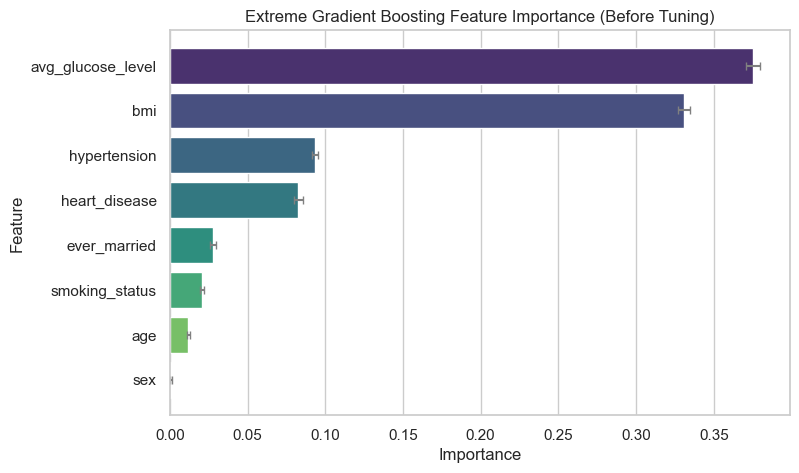

In [90]:
plot_permutation_importance(xgb_model, risk_factors_test, target_test, x.columns, 
                            title='Extreme Gradient Boosting Feature Importance (Before Tuning)', scoring='accuracy')

##### Hyperparameter Tuning

In [70]:
xgb_param_grid = {
    'learning_rate': [0.01, 0.02],
    'n_estimators': [500, 1000],
    'max_depth': [3, 4, 5],
    'min_child_weight': [10, 12],
    'gamma': [0.8, 1],
    'subsample': [0.5, 0.6],
    'colsample_bytree': [0.4, 0.5],
    'lambda': [1, 1.5],  # L2 regularization
    'alpha': [0, 0.5]    # L1 regularization
}

xgb_grid_search = GridSearchCV(xgb_model, xgb_param_grid, cv=5, refit = True, n_jobs=-1, verbose=1)

xgb_grid_search.fit(risk_factors_train, target_train)

print("Best Hyperparameters:", xgb_grid_search.best_params_)
print("Best Mean Cross-validated Score:", xgb_grid_search.best_score_)

Fitting 5 folds for each of 768 candidates, totalling 3840 fits
Best Hyperparameters: {'alpha': 0.5, 'colsample_bytree': 0.5, 'gamma': 1, 'lambda': 1, 'learning_rate': 0.02, 'max_depth': 5, 'min_child_weight': 10, 'n_estimators': 1000, 'subsample': 0.6}
Best Mean Cross-validated Score: 0.9228512131792452


##### After Hyperparameter Tuning

After Hyperparamater Tuning: 
Training Accuracy:  0.9313102000493949
Testing Accuracy:  0.9228204494937021
Specificity (True Negative Rate):  0.8857213074465471

Classification Report: 
               precision    recall  f1-score   support

   No Stroke     0.9575    0.8857    0.9202      4069
      Stroke     0.8927    0.9603    0.9253      4029

    accuracy                         0.9228      8098
   macro avg     0.9251    0.9230    0.9227      8098
weighted avg     0.9253    0.9228    0.9227      8098



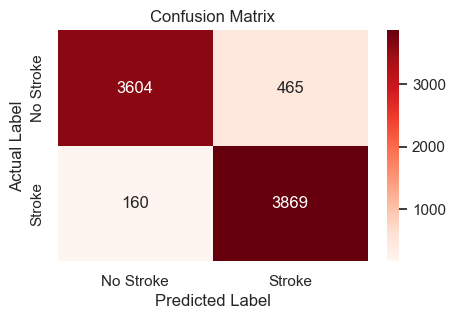

In [22]:
# Best hyperparameters obtained from grid search
xgb_best_params = {'learning_rate': 0.02, 
               'n_estimators': 1000, 
               'max_depth': 5, 
               'min_child_weight': 10, 
               'gamma': 1,
               'subsample': 0.6,
               'colsample_bytree': 0.5,
               'lambda': 1,
               'alpha': 0.5}

# Initialize a new RF model with the best hyperparameters
xgb_tuned_model = XGBClassifier(**xgb_best_params, random_state=42)

# Train the model with training data
xgb_tuned_model.fit(risk_factors_train, target_train)

# Test the model with training and testing data
xgb_target_pred_train = xgb_tuned_model.predict(risk_factors_train)
xgb_target_pred_test = xgb_tuned_model.predict(risk_factors_test)

# Calculate accuracy
xgb_train_accuracy = accuracy_score(target_train, xgb_target_pred_train)
xgb_test_accuracy = accuracy_score(target_test, xgb_target_pred_test)
test_conf_matrix = confusion_matrix(target_test, xgb_target_pred_test)
tn, fp, fn, tp = test_conf_matrix.ravel()
specificity = tn / (tn + fp)

# Calculate precision, recall, F1-score
precision = precision_score(target_test, xgb_target_pred_test, average='macro')
recall = recall_score(target_test, xgb_target_pred_test, average='macro')
f1 = f1_score(target_test, xgb_target_pred_test, average='macro')

# Classification report
xgb_test_report = classification_report(target_test, xgb_target_pred_test, target_names=target_names, digits=4)

print("After Hyperparamater Tuning: ")
print("Training Accuracy: ", xgb_train_accuracy)
print("Testing Accuracy: ", xgb_test_accuracy)
print("Specificity (True Negative Rate): ", specificity)
print("\nClassification Report: \n", xgb_test_report)

# Confusion Matrix
test_conf_matrix = confusion_matrix(target_test, xgb_target_pred_test)
plt.figure(figsize=(5, 3))
sns.heatmap(test_conf_matrix, annot=True, cmap='Reds', fmt='d', xticklabels=target_names, yticklabels=target_names)
plt.xlabel('Predicted Label')
plt.ylabel('Actual Label')
plt.title('Confusion Matrix')
plt.show()

In [68]:
# Append the XGBoost model's metrics
new_row = pd.DataFrame({
    'Model': ['XGB'],
    'Accuracy': [None],
    'Specificity': [specificity],
    'Precision': [precision],
    'Recall': [recall],
    'F1 Score': [f1]
})

metrics_df = pd.concat([metrics_df, new_row], ignore_index=True)

print("Model Evaluation Metrics without Accuracy:")
print(metrics_df)

Model Evaluation Metrics without Accuracy:
  Model  Accuracy  Precision    Recall  F1 Score  Specificity
0    DT  0.974636   0.975620  0.975586  0.975549     0.968297
1    LR  0.640282   0.685560  0.679350  0.676945     0.769968
2    GB  0.909879   0.909954  0.909896  0.909853     0.901450
3    RF  0.934972   0.932110  0.931640  0.931687     0.946178
4   XGB      None   0.925100  0.923005  0.922738     0.885721


<module 'matplotlib.pyplot' from 'c:\\Users\\tanky\\AppData\\Local\\Programs\\Python\\Python312\\Lib\\site-packages\\matplotlib\\pyplot.py'>

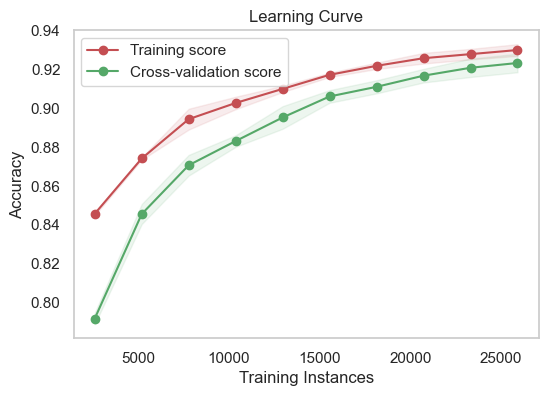

In [121]:
plot_learning_curve(xgb_tuned_model, risk_factors_train, target_train, 5, scoring='accuracy')

In [39]:
# Cross-validation
# Perform cross-validation with train and test scores
xgb_cv_results = cross_validate(xgb_tuned_model, x, y, cv=5, return_train_score=True)

# Print cross-validation results
print("Train Accuracy:", xgb_cv_results['train_score'])
print("Mean Train Accuracy:", xgb_cv_results['train_score'].mean())
print("Test Accuracy:", xgb_cv_results['test_score'])
print("Mean Test Accuracy:", xgb_cv_results['test_score'].mean())

Train Accuracy: [0.93257594 0.93189676 0.92995184 0.93035317 0.94038652]
Mean Train Accuracy: 0.9330328476166955
Test Accuracy: [0.92170906 0.9291183  0.91812793 0.92664856 0.94035564]
Mean Test Accuracy: 0.9271918992343788


In [70]:
metrics_df.loc[metrics_df['Model'] == 'XGB', 'Accuracy'] = xgb_cv_results['test_score'].mean()
print(metrics_df)

  Model  Accuracy  Precision    Recall  F1 Score  Specificity
0    DT  0.974636   0.975620  0.975586  0.975549     0.968297
1    LR  0.640282   0.685560  0.679350  0.676945     0.769968
2    GB  0.909879   0.909954  0.909896  0.909853     0.901450
3    RF  0.934972   0.932110  0.931640  0.931687     0.946178
4   XGB  0.927192   0.925100  0.923005  0.922738     0.885721
5   DNN  0.859379        NaN       NaN       NaN          NaN


C:\Users\tsfat\AppData\Local\Temp\ipykernel_17388\280330674.py:21: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='Importance', y='Feature', data=feature_importance_df, palette='viridis', ci=None)
C:\Users\tsfat\AppData\Local\Temp\ipykernel_17388\280330674.py:21: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Importance', y='Feature', data=feature_importance_df, palette='viridis', ci=None)


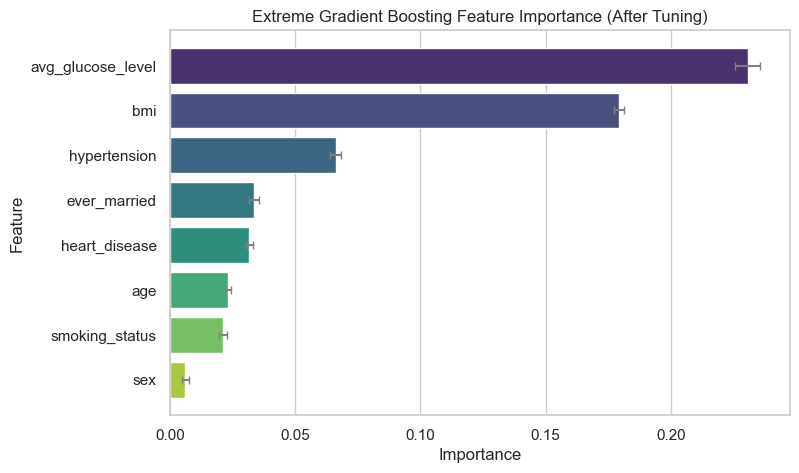

In [94]:
plot_permutation_importance(xgb_tuned_model, risk_factors_test, target_test, x.columns, 
                            title='Extreme Gradient Boosting Feature Importance (After Tuning)', scoring='accuracy')

SHAP values shape: [(8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8,), (8

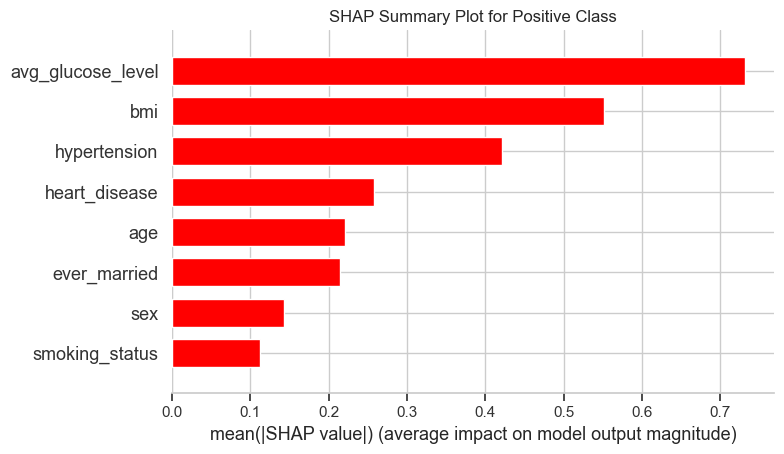

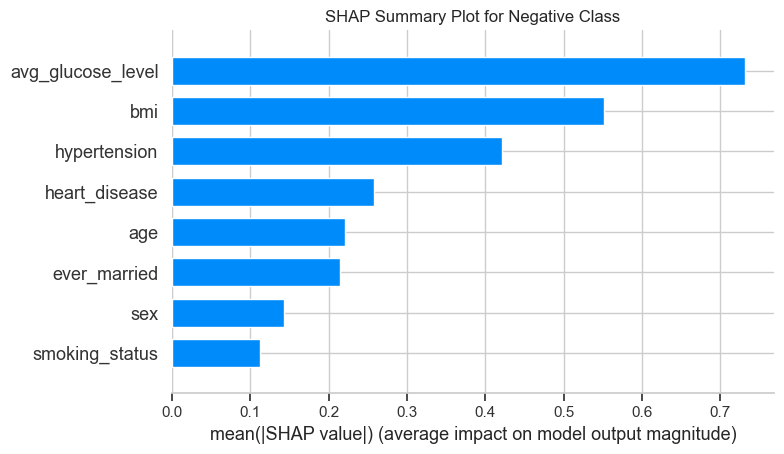

In [60]:
import shap

risk_factors_train_df = pd.DataFrame(risk_factors_train, columns=x.columns)
risk_factors_test_df = pd.DataFrame(risk_factors_test, columns=x.columns)

# Initialize the SHAP TreeExplainer
# Initialize the SHAP TreeExplainer
explainer = shap.TreeExplainer(xgb_tuned_model)

# Calculate SHAP values for the test data
shap_values = explainer.shap_values(risk_factors_test)

# Print the shape of SHAP values and risk_factors_test to ensure they match
print("SHAP values shape:", [sv.shape for sv in shap_values])  # shap_values is a list
print("Risk factors test shape:", risk_factors_test.shape)

# If shap_values is a list with two elements, we can assume it's for binary classification
if isinstance(shap_values, list) and len(shap_values) == 2:
    positive_shap_values = shap_values[1]  # Select the SHAP values for the positive class
    negative_shap_values = shap_values[0]  # Negative class
elif isinstance(shap_values, np.ndarray) and shap_values.ndim == 2:
    # Assuming the output is already the SHAP values for the positive class
    positive_shap_values = shap_values
    negative_shap_values = -shap_values  # Invert the SHAP values for the negative class
else:
    raise ValueError("Unexpected structure of shap_values")

# Plot SHAP summary plot for the positive class
plt.figure(figsize=(10, 6))  # Set the figure size
shap.summary_plot(positive_shap_values, risk_factors_test, feature_names=x.columns, plot_type="bar", color='red', show=False)
plt.title("SHAP Summary Plot for Positive Class")
plt.tight_layout()  # Adjust layout to make room for the title
plt.show()

# Plot SHAP summary plot for the negative class
plt.figure(figsize=(10, 6))  # Set the figure size
shap.summary_plot(negative_shap_values, risk_factors_test, feature_names=x.columns, plot_type="bar", show=False)
plt.title("SHAP Summary Plot for Negative Class")
plt.tight_layout()  # Adjust layout to make room for the title
plt.show()

In [77]:
exp = explain_stroke_instance(risk_factors_train, risk_factors_test, target_test, xgb_tuned_model, x, 1)

Original Values:    sex   age  hypertension  heart_disease  ever_married  avg_glucose_level  \
0  1.0  19.0           1.0            0.0           1.0             194.37   

    bmi  smoking_status  
0  27.0             1.0  


In [78]:
exp = explain_stroke_instance(risk_factors_train, risk_factors_test, target_test, xgb_tuned_model, x, 0)

Original Values:    sex   age  hypertension  heart_disease  ever_married  avg_glucose_level  \
0  1.0  73.0           0.0            0.0           1.0               93.9   

    bmi  smoking_status  
0  42.2             0.0  


#### Deep Neural Network (DNN)

##### Before Hyperparameter Tuning

In [44]:
from scikeras.wrappers import KerasClassifier 

# Define the function to build the base model
def create_base_model():
    model = Sequential([
        Input(shape=(risk_factors_train.shape[1],)),
        Dense(128, activation='relu', kernel_regularizer=tf.keras.regularizers.l2(0.01)),
        Dense(64, activation='relu'),
        Dropout(0.3),
        Dense(32, activation='relu'),
        Dropout(0.3),
        Dense(1, activation='sigmoid')
    ])
    model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])
    return model

In [45]:
base_model = KerasClassifier(build_fn=create_base_model, epochs=20, batch_size=32, verbose=1)
base_history = base_model.fit(risk_factors_train, target_train, validation_data=(risk_factors_test, target_test))

Epoch 1/20


c:\Users\tsfat\AppData\Local\Programs\Python\Python312\Lib\site-packages\scikeras\wrappers.py:925: UserWarning:

``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.



1013/1013 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/step - accuracy: 0.6718 - loss: 0.6746 - val_accuracy: 0.6973 - val_loss: 0.5930
Epoch 2/20
1013/1013 ━━━━━━━━━━━━━━━━━━━━ 1s 918us/step - accuracy: 0.7112 - loss: 0.5838 - val_accuracy: 0.7082 - val_loss: 0.5725
Epoch 3/20
1013/1013 ━━━━━━━━━━━━━━━━━━━━ 1s 909us/step - accuracy: 0.7157 - loss: 0.5667 - val_accuracy: 0.7204 - val_loss: 0.5610
Epoch 4/20
1013/1013 ━━━━━━━━━━━━━━━━━━━━ 1s 882us/step - accuracy: 0.7232 - loss: 0.5563 - val_accuracy: 0.7236 - val_loss: 0.5457
Epoch 5/20
1013/1013 ━━━━━━━━━━━━━━━━━━━━ 1s 871us/step - accuracy: 0.7287 - loss: 0.5454 - val_accuracy: 0.7239 - val_loss: 0.5359
Epoch 6/20
1013/1013 ━━━━━━━━━━━━━━━━━━━━ 1s 859us/step - accuracy: 0.7430 - loss: 0.5254 - val_accuracy: 0.7443 - val_loss: 0.5120
Epoch 7/20
1013/1013 ━━━━━━━━━━━━━━━━━━━━ 1s 916us/step - accuracy: 0.7472 - loss: 0.5156 - val_accuracy: 0.7541 - val_loss: 0.4992
Epoch 8/20
1013/1013 ━━━━━━━━━━━━━━━━━━━━ 1s 868us/step - accuracy: 0.7563 - loss: 0.5004

In [47]:
base_history = base_model.model_.history

1013/1013 ━━━━━━━━━━━━━━━━━━━━ 1s 520us/step
254/254 ━━━━━━━━━━━━━━━━━━━━ 0s 467us/step
Training Accuracy:  0.8189059026920227
Testing Accuracy:  0.80649543097061
Specificity (True Negative Rate):  0.7616121897272057

Classification Report: 
               precision    recall  f1-score   support

   No Stroke     0.8385    0.7616    0.7982      4069
      Stroke     0.7796    0.8518    0.8141      4029

    accuracy                         0.8065      8098
   macro avg     0.8091    0.8067    0.8062      8098
weighted avg     0.8092    0.8065    0.8061      8098



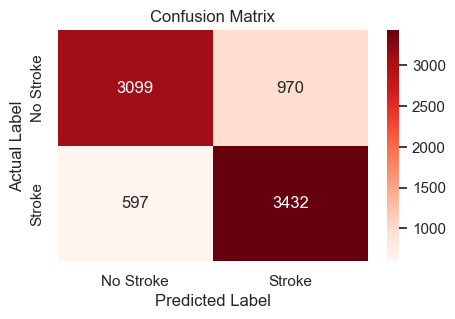

In [46]:
# Test the DNN model with training and testing data
dnn_target_pred_train = (base_model.predict(risk_factors_train) > 0.5).astype("int32")
dnn_target_pred_test = (base_model.predict(risk_factors_test) > 0.5).astype("int32")

#Calculate accuracy
dnn_train_accuracy = accuracy_score(target_train, dnn_target_pred_train)
dnn_test_accuracy = accuracy_score(target_test, dnn_target_pred_test)
test_conf_matrix = confusion_matrix(target_test, dnn_target_pred_test)
tn, fp, fn, tp = test_conf_matrix.ravel()
specificity = tn / (tn + fp)

# Classification report
dnn_test_report = classification_report(target_test, dnn_target_pred_test, target_names=target_names, digits=4)

print("Training Accuracy: ", dnn_train_accuracy)
print("Testing Accuracy: ", dnn_test_accuracy)
print("Specificity (True Negative Rate): ", specificity)
print("\nClassification Report: \n", dnn_test_report)

# Confusion Matrix
test_conf_matrix = confusion_matrix(target_test, dnn_target_pred_test)
plt.figure(figsize=(5, 3))
sns.heatmap(test_conf_matrix, annot=True, cmap='Reds', fmt='d', xticklabels=target_names, yticklabels=target_names)
plt.xlabel('Predicted Label')
plt.ylabel('Actual Label')
plt.title('Confusion Matrix')
plt.show()

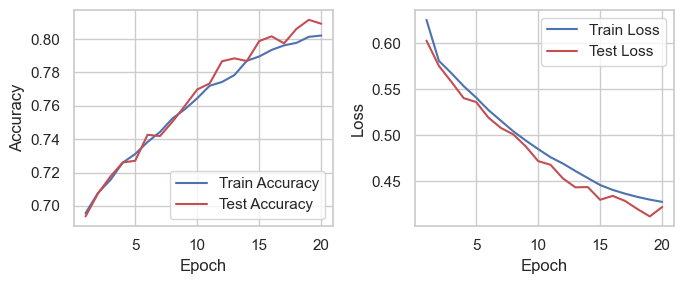

In [18]:
acc2 = base_history.history['accuracy']
val_acc = base_history.history['val_accuracy']
loss2 = base_history.history['loss']
val_loss = base_history.history['val_loss']
 
epochs = range(1,len(acc2)+1)
 
# Creating subplots
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(7,3))
 
axes[0].plot(epochs, acc2,'b',label='Train Accuracy')
axes[0].plot(epochs, val_acc,'r',label='Test Accuracy')
axes[0].set_xlabel('Epoch')
axes[0].set_ylabel('Accuracy')
axes[0].legend()
 
axes[1].plot(epochs, loss2,'b',label='Train Loss')
axes[1].plot(epochs, val_loss,'r',label='Test Loss')
axes[1].set_xlabel('Epoch')
axes[1].set_ylabel('Loss')
axes[1].legend()
 
# Adjusting layout for better spacing
plt.tight_layout()
 
# Display the figure
plt.show()

254/254 ━━━━━━━━━━━━━━━━━━━━ 0s 486us/step
254/254 ━━━━━━━━━━━━━━━━━━━━ 0s 410us/step
254/254 ━━━━━━━━━━━━━━━━━━━━ 0s 428us/step
254/254 ━━━━━━━━━━━━━━━━━━━━ 0s 455us/step
254/254 ━━━━━━━━━━━━━━━━━━━━ 0s 472us/step
254/254 ━━━━━━━━━━━━━━━━━━━━ 0s 427us/step
254/254 ━━━━━━━━━━━━━━━━━━━━ 0s 438us/step
254/254 ━━━━━━━━━━━━━━━━━━━━ 0s 583us/step
254/254 ━━━━━━━━━━━━━━━━━━━━ 0s 438us/step
254/254 ━━━━━━━━━━━━━━━━━━━━ 0s 397us/step
254/254 ━━━━━━━━━━━━━━━━━━━━ 0s 390us/step
254/254 ━━━━━━━━━━━━━━━━━━━━ 0s 444us/step
254/254 ━━━━━━━━━━━━━━━━━━━━ 0s 424us/step
254/254 ━━━━━━━━━━━━━━━━━━━━ 0s 424us/step
254/254 ━━━━━━━━━━━━━━━━━━━━ 0s 438us/step
254/254 ━━━━━━━━━━━━━━━━━━━━ 0s 412us/step
254/254 ━━━━━━━━━━━━━━━━━━━━ 0s 516us/step
254/254 ━━━━━━━━━━━━━━━━━━━━ 0s 466us/step
254/254 ━━━━━━━━━━━━━━━━━━━━ 0s 472us/step
254/254 ━━━━━━━━━━━━━━━━━━━━ 0s 423us/step
254/254 ━━━━━━━━━━━━━━━━━━━━ 0s 431us/step
254/254 ━━━━━━━━━━━━━━━━━━━━ 0s 398us/step
254/254 ━━━━━━━━━━━━━━━━━━━━ 0s 412us/step
254/254 ━━━

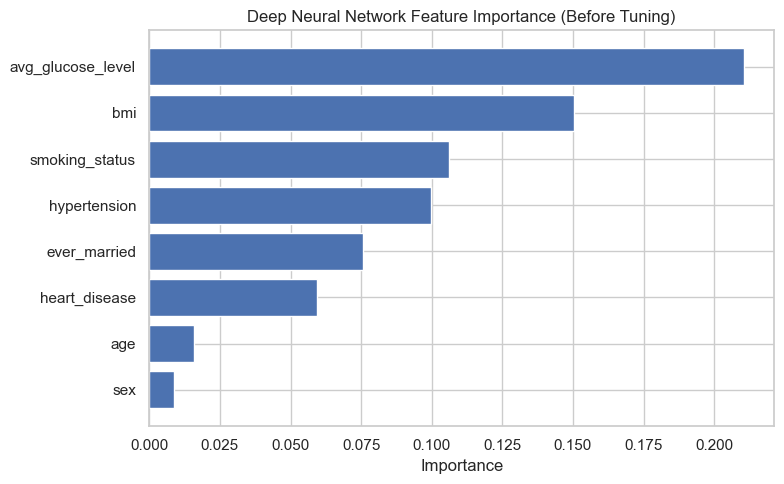

In [48]:
from sklearn.inspection import permutation_importance

feature_names = np.array(x.columns)

# Calculate permutation feature importance
perm_importance = permutation_importance(base_model, risk_factors_test, target_test, n_repeats=10, random_state=42)

# Sort indices by importance
sorted_idx = perm_importance.importances_mean.argsort()

# Plot permutation feature importance
plt.figure(figsize=(8, 5))
plt.barh(feature_names[sorted_idx], perm_importance.importances_mean[sorted_idx])
plt.xlabel("Importance")
plt.title("Deep Neural Network Feature Importance (Before Tuning)")
plt.tight_layout()
plt.show()

##### Hyperparameter Tuning

In [19]:
from scikeras.wrappers import KerasClassifier 

def create_model(neurons_1=64, neurons_2=64, neurons_3=64, optimizer='adam', dropout_rate=0.2, regularizer=0.1):
    model = Sequential()
    model.add(Input(shape=(risk_factors_train.shape[1],)))
    model.add(Dense(neurons_1, activation='relu', kernel_regularizer=tf.keras.regularizers.l2(regularizer)))
    model.add(Dense(neurons_2, activation='relu'))
    model.add(Dropout(dropout_rate))
    model.add(Dense(neurons_3, activation='relu'))
    model.add(Dropout(dropout_rate))
    model.add(Dense(1, activation='sigmoid'))
    
    model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])
    return model

model = KerasClassifier(build_fn=create_model, epochs=20, batch_size=32)

In [20]:
dnn_param_grid = {
    'model__neurons_1': [128, 256],
    'model__neurons_2': [32, 64, 128],
    'model__neurons_3': [16, 32, 64],
    'model__dropout_rate': [0.2, 0.3],
    'model__regularizer': [0.1, 0.001],
}

# Create the GridSearchCV object
dnn_grid_search = GridSearchCV(estimator=model, param_grid=dnn_param_grid, n_jobs=-1, cv=5, verbose=2)

# Fit the grid search
dnn_grid_search.fit(risk_factors_train, target_train)

# Print the best parameters and the best score
print("Best Hyperparameters:", dnn_grid_search.best_params_)
print("Best Mean Cross-validated Score:", dnn_grid_search.best_score_)

Fitting 5 folds for each of 72 candidates, totalling 360 fits


c:\Users\tsfat\AppData\Local\Programs\Python\Python312\Lib\site-packages\scikeras\wrappers.py:925: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)


Epoch 1/20
1013/1013 ━━━━━━━━━━━━━━━━━━━━ 5s 1ms/step - accuracy: 0.6919 - loss: 0.6012
Epoch 2/20
1013/1013 ━━━━━━━━━━━━━━━━━━━━ 1s 980us/step - accuracy: 0.7146 - loss: 0.5676
Epoch 3/20
1013/1013 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - accuracy: 0.7305 - loss: 0.5394
Epoch 4/20
1013/1013 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - accuracy: 0.7390 - loss: 0.5141
Epoch 5/20
1013/1013 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - accuracy: 0.7514 - loss: 0.4913
Epoch 6/20
1013/1013 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - accuracy: 0.7670 - loss: 0.4662
Epoch 7/20
1013/1013 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - accuracy: 0.7858 - loss: 0.4423
Epoch 8/20
1013/1013 ━━━━━━━━━━━━━━━━━━━━ 1s 998us/step - accuracy: 0.7867 - loss: 0.4341
Epoch 9/20
1013/1013 ━━━━━━━━━━━━━━━━━━━━ 1s 991us/step - accuracy: 0.7933 - loss: 0.4244
Epoch 10/20
1013/1013 ━━━━━━━━━━━━━━━━━━━━ 1s 986us/step - accuracy: 0.8093 - loss: 0.4046
Epoch 11/20
1013/1013 ━━━━━━━━━━━━━━━━━━━━ 1s 983us/step - accuracy: 0.8151 - loss: 0.3960
Epoch 12/20
1013/101

In [69]:
# Append the XGBoost model's metrics
dnn_mean_accuracy = dnn_grid_search.best_score_

new_row = pd.DataFrame({
    'Model': ['DNN'],
    'Accuracy': [dnn_mean_accuracy],
    'Specificity': [None],
    'Precision': [None],
    'Recall': [None],
    'F1 Score': [None]
})

metrics_df = pd.concat([metrics_df, new_row], ignore_index=True)

print("Model Evaluation Metrics without Accuracy:")
print(metrics_df)

Model Evaluation Metrics without Accuracy:
  Model  Accuracy  Precision    Recall  F1 Score  Specificity
0    DT  0.974636   0.975620  0.975586  0.975549     0.968297
1    LR  0.640282   0.685560  0.679350  0.676945     0.769968
2    GB  0.909879   0.909954  0.909896  0.909853     0.901450
3    RF  0.934972   0.932110  0.931640  0.931687     0.946178
4   XGB      None   0.925100  0.923005  0.922738     0.885721
5   DNN  0.859379        NaN       NaN       NaN          NaN


C:\Users\tsfat\AppData\Local\Temp\ipykernel_6492\155030895.py:13: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  metrics_df = pd.concat([metrics_df, new_row], ignore_index=True)


##### After Hyperparameter Tuning

In [49]:
# Define the function to build the tuned model
def create_tuned_dnn_model():
    tuned_dnn_model = Sequential([
        Input(shape=(risk_factors_train.shape[1],)), # Input layer
        Dense(256, activation='relu', kernel_regularizer=tf.keras.regularizers.l2(0.001)), # Hidden layer 1
        Dense(128, activation='relu'), # Hidden layer 2
        Dropout(0.2), # Dropout rate
        Dense(64, activation='relu'), # Hidden layer 3
        Dropout(0.2), # Dropout rate
        Dense(1, activation='sigmoid') # Output layer
    ])

    # Compile the model
    tuned_dnn_model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])
    
    return tuned_dnn_model

def lr_schedule(epoch, lr):
    if epoch < 10:
        return lr
    else:
        return tf.keras.backend.eval(lr * tf.math.exp(-0.1))

# Early stopping callback
early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)


In [50]:
tuned_model = KerasClassifier(build_fn=create_tuned_dnn_model, epochs=20, batch_size=32, verbose=1)
history = tuned_model.fit(risk_factors_train, target_train, validation_data=(risk_factors_test, target_test), 
                          callbacks=[LearningRateScheduler(lr_schedule), early_stopping])

Epoch 1/20


c:\Users\tsfat\AppData\Local\Programs\Python\Python312\Lib\site-packages\scikeras\wrappers.py:925: UserWarning:

``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.



1013/1013 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/step - accuracy: 0.6916 - loss: 0.6031 - val_accuracy: 0.7061 - val_loss: 0.5720
Epoch 2/20
1013/1013 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - accuracy: 0.7132 - loss: 0.5623 - val_accuracy: 0.7208 - val_loss: 0.5446
Epoch 3/20
1013/1013 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - accuracy: 0.7315 - loss: 0.5351 - val_accuracy: 0.7327 - val_loss: 0.5204
Epoch 4/20
1013/1013 ━━━━━━━━━━━━━━━━━━━━ 1s 998us/step - accuracy: 0.7412 - loss: 0.5173 - val_accuracy: 0.7534 - val_loss: 0.4932
Epoch 5/20
1013/1013 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - accuracy: 0.7539 - loss: 0.4884 - val_accuracy: 0.7620 - val_loss: 0.4723
Epoch 6/20
1013/1013 ━━━━━━━━━━━━━━━━━━━━ 1s 957us/step - accuracy: 0.7689 - loss: 0.4699 - val_accuracy: 0.7775 - val_loss: 0.4521
Epoch 7/20
1013/1013 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - accuracy: 0.7764 - loss: 0.4542 - val_accuracy: 0.7944 - val_loss: 0.4252
Epoch 8/20
1013/1013 ━━━━━━━━━━━━━━━━━━━━ 1s 984us/step - accuracy: 0.7851 - loss: 0.4326 - val_a

In [51]:
tuned_history = tuned_model.model_.history

1013/1013 ━━━━━━━━━━━━━━━━━━━━ 1s 533us/step
254/254 ━━━━━━━━━━━━━━━━━━━━ 0s 438us/step
Training Accuracy:  0.8683316868362558
Testing Accuracy:  0.8663867621634972
Specificity (True Negative Rate):  0.7972474809535512

Classification Report: 
               precision    recall  f1-score   support

   No Stroke     0.9266    0.7972    0.8571      4069
      Stroke     0.8205    0.9362    0.8746      4029

    accuracy                         0.8664      8098
   macro avg     0.8736    0.8667    0.8658      8098
weighted avg     0.8738    0.8664    0.8658      8098



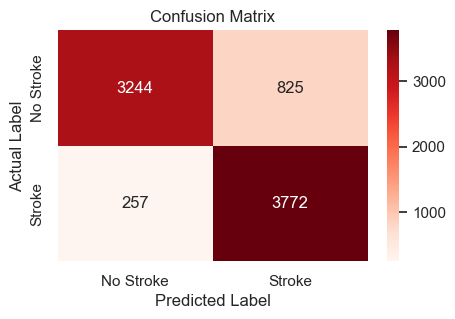

In [52]:
# Test the DNN model with training and testing data
dnn_target_pred_train = (tuned_model.predict(risk_factors_train) > 0.5).astype("int32")
dnn_target_pred_test = (tuned_model.predict(risk_factors_test) > 0.5).astype("int32")

#Calculate accuracy
dnn_train_accuracy = accuracy_score(target_train, dnn_target_pred_train)
dnn_test_accuracy = accuracy_score(target_test, dnn_target_pred_test)
test_conf_matrix = confusion_matrix(target_test, dnn_target_pred_test)
tn, fp, fn, tp = test_conf_matrix.ravel()
specificity = tn / (tn + fp)

# Calculate precision, recall, F1-score
precision = precision_score(target_test, dnn_target_pred_test, average='macro')
recall = recall_score(target_test, dnn_target_pred_test, average='macro')
f1 = f1_score(target_test, dnn_target_pred_test, average='macro')

# Classification report
dnn_test_report = classification_report(target_test, dnn_target_pred_test, target_names=target_names, digits=4)

print("Training Accuracy: ", dnn_train_accuracy)
print("Testing Accuracy: ", dnn_test_accuracy)
print("Specificity (True Negative Rate): ", specificity)
print("\nClassification Report: \n", dnn_test_report)

# Confusion Matrix
test_conf_matrix = confusion_matrix(target_test, dnn_target_pred_test)
plt.figure(figsize=(5, 3))
sns.heatmap(test_conf_matrix, annot=True, cmap='Reds', fmt='d', xticklabels=target_names, yticklabels=target_names)
plt.xlabel('Predicted Label')
plt.ylabel('Actual Label')
plt.title('Confusion Matrix')
plt.show()

In [ ]:
# Append the values to the data frame
metrics_df.loc[metrics_df['Model'] == 'DNN', 'Specificity'] = specificity
metrics_df.loc[metrics_df['Model'] == 'DNN', 'Precision'] = precision
metrics_df.loc[metrics_df['Model'] == 'DNN', 'Recall'] = recall
metrics_df.loc[metrics_df['Model'] == 'DNN', 'F1 Score'] = f1

In [73]:
# Store the base model performance df to csv for further use
metrics_df.to_csv('base_model_performance.csv', index=False)

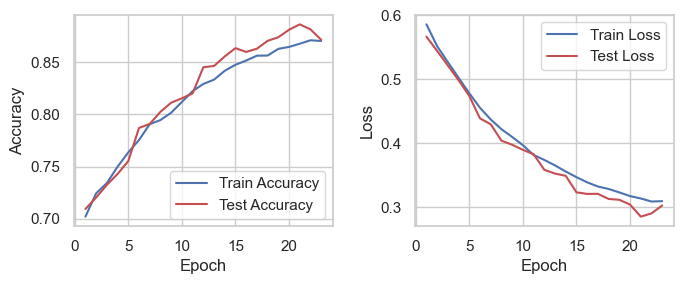

In [58]:
acc2 = tuned_history.history['accuracy']
val_acc = tuned_history.history['val_accuracy']
loss2 = tuned_history.history['loss']
val_loss = tuned_history.history['val_loss']
 
epochs = range(1,len(acc2)+1)
 
# Creating subplots
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(7,3))
 
axes[0].plot(epochs, acc2,'b',label='Train Accuracy')
axes[0].plot(epochs, val_acc,'r',label='Test Accuracy')
axes[0].set_xlabel('Epoch')
axes[0].set_ylabel('Accuracy')
axes[0].legend()
 
axes[1].plot(epochs, loss2,'b',label='Train Loss')
axes[1].plot(epochs, val_loss,'r',label='Test Loss')
axes[1].set_xlabel('Epoch')
axes[1].set_ylabel('Loss')
axes[1].legend()
 
# Adjusting layout for better spacing
plt.tight_layout()
 
# Display the figure
plt.show()

254/254 ━━━━━━━━━━━━━━━━━━━━ 0s 498us/step
254/254 ━━━━━━━━━━━━━━━━━━━━ 0s 389us/step
254/254 ━━━━━━━━━━━━━━━━━━━━ 0s 418us/step
254/254 ━━━━━━━━━━━━━━━━━━━━ 0s 572us/step
254/254 ━━━━━━━━━━━━━━━━━━━━ 0s 439us/step
254/254 ━━━━━━━━━━━━━━━━━━━━ 0s 410us/step
254/254 ━━━━━━━━━━━━━━━━━━━━ 0s 438us/step
254/254 ━━━━━━━━━━━━━━━━━━━━ 0s 453us/step
254/254 ━━━━━━━━━━━━━━━━━━━━ 0s 438us/step
254/254 ━━━━━━━━━━━━━━━━━━━━ 0s 468us/step
254/254 ━━━━━━━━━━━━━━━━━━━━ 0s 460us/step
254/254 ━━━━━━━━━━━━━━━━━━━━ 0s 505us/step
254/254 ━━━━━━━━━━━━━━━━━━━━ 0s 473us/step
254/254 ━━━━━━━━━━━━━━━━━━━━ 0s 420us/step
254/254 ━━━━━━━━━━━━━━━━━━━━ 0s 442us/step
254/254 ━━━━━━━━━━━━━━━━━━━━ 0s 531us/step
254/254 ━━━━━━━━━━━━━━━━━━━━ 0s 498us/step
254/254 ━━━━━━━━━━━━━━━━━━━━ 0s 695us/step
254/254 ━━━━━━━━━━━━━━━━━━━━ 0s 438us/step
254/254 ━━━━━━━━━━━━━━━━━━━━ 0s 411us/step
254/254 ━━━━━━━━━━━━━━━━━━━━ 0s 577us/step
254/254 ━━━━━━━━━━━━━━━━━━━━ 0s 439us/step
254/254 ━━━━━━━━━━━━━━━━━━━━ 0s 438us/step
254/254 ━━━

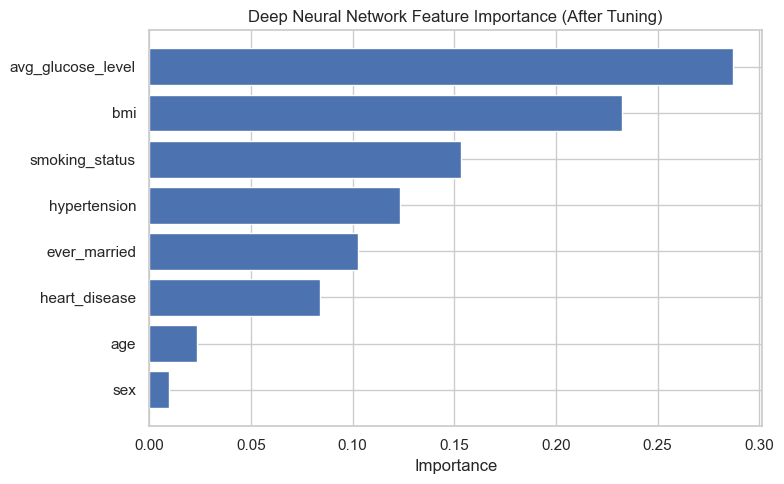

In [54]:
# Calculate permutation feature importance
perm_importance = permutation_importance(tuned_model, risk_factors_test, target_test, n_repeats=10, random_state=42)

# Sort indices by importance
sorted_idx = perm_importance.importances_mean.argsort()

# Plot permutation feature importance
plt.figure(figsize=(8, 5))
plt.barh(feature_names[sorted_idx], perm_importance.importances_mean[sorted_idx])
plt.xlabel("Importance")
plt.title("Deep Neural Network Feature Importance (After Tuning)")
plt.tight_layout()
plt.show()

#### Base Model Evaluation

In [41]:
import pandas as pd
import plotly.express as px

# Load the CSV file
file_path = 'base_model_performance.csv' 
df = pd.read_csv(file_path)

# Convert the DataFrame to a long format suitable for plotting
df_long = df.melt(id_vars='Model', var_name='Metric', value_name='Score')

df_long['Score'] = df_long['Score'] * 100

# Plot the graph
fig = px.bar(df_long, x='Metric', y='Score', color='Model', barmode='group', 
             category_orders={"Metric": ["Accuracy", "Precision", "Recall", "F1 Score", "Specificity"]},
             labels={"Score": "Score (%)", "Metric": "Evaluation Metric"},
             title="Base Model Evaluation Metrics Score",
             width=1300, height=700, 
             color_discrete_sequence=px.colors.qualitative.Pastel1)

fig.update_traces(texttemplate='%{y:.2f}', textposition='outside')

# Layout
fig.update_layout(
    xaxis_title="Evaluation Metric",
    yaxis_title="Score (%)",
    legend_title="Models",
    title_x=0.5,
    title_font_size=20,
    xaxis_tickangle=-45,
    paper_bgcolor='white', 
    plot_bgcolor='white', 
    font=dict(color='black'), 
    xaxis=dict(showgrid=True, gridcolor='lightgrey'), 
    yaxis=dict(showgrid=True, gridcolor='lightgrey'),   
    margin=dict(t=50, b=150)
)

# Show plot
fig.show()

In [53]:
# Initialize the DataFrame to store the evaluation matrix scores for further use (ensemble models)
columns = ['Model', 'Accuracy', 'Precision', 'Recall', 'F1 Score', 'Specificity']
ensmeble_metrics_df = pd.DataFrame(columns=columns)

#### Voting

##### Soft Voting

###### Combination 1

Training Accuracy:  0.9877438873796
Testing Accuracy:  0.9809829587552482
Specificity (True Negative Rate):  0.9729663307938068

Classification Report: 
               precision    recall  f1-score   support

   No Stroke     0.9890    0.9730    0.9809      4069
      Stroke     0.9731    0.9891    0.9810      4029

    accuracy                         0.9810      8098
   macro avg     0.9811    0.9810    0.9810      8098
weighted avg     0.9811    0.9810    0.9810      8098



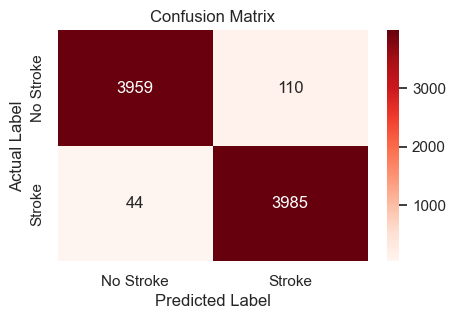

In [64]:
# DF, GB, RF, XGB - TOP 4

soft_voting_model_1 = VotingClassifier(estimators=[
    ('rf', rf_tuned_model), 
    ('gb', gb_tuned_model),
    ('dt', dt_tuned_model),
    ('xgb', xgb_tuned_model),
], voting='soft')

# Train the soft voting model with training data
soft_voting_model_1.fit(risk_factors_train, target_train)

# Test the soft voting model with training and testing data
soft_voting_target_pred_train_1 = soft_voting_model_1.predict(risk_factors_train)
soft_voting_target_pred_test_1 = soft_voting_model_1.predict(risk_factors_test)

# Calculate accuracy
soft_voting_train_accuracy_1 = accuracy_score(target_train, soft_voting_target_pred_train_1)
soft_voting_test_accuracy_1 = accuracy_score(target_test, soft_voting_target_pred_test_1)
# Calculate specificity (true negative rate)
test_conf_matrix = confusion_matrix(target_test, soft_voting_target_pred_test_1)
tn, fp, fn, tp = test_conf_matrix.ravel()
specificity_1 = tn / (tn + fp)

# Calculate precision, recall, F1-score
precision_1 = precision_score(target_test, soft_voting_target_pred_test_1, average='macro')
recall_1 = recall_score(target_test, soft_voting_target_pred_test_1, average='macro')
f1_1 = f1_score(target_test, soft_voting_target_pred_test_1, average='macro')

# Classification report
soft_voting_test_report_1 = classification_report(target_test, soft_voting_target_pred_test_1, target_names=target_names, digits=4)

print("Training Accuracy: ", soft_voting_train_accuracy_1)
print("Testing Accuracy: ", soft_voting_test_accuracy_1)
print("Specificity (True Negative Rate): ", specificity_1)
print("\nClassification Report: \n", soft_voting_test_report_1)

# Confusion Matrix
test_conf_matrix = confusion_matrix(target_test, soft_voting_target_pred_test_1)
plt.figure(figsize=(5, 3))
sns.heatmap(test_conf_matrix, annot=True, cmap='Reds', fmt='d', xticklabels=target_names, yticklabels=target_names)
plt.xlabel('Predicted Label')
plt.ylabel('Actual Label')
plt.title('Confusion Matrix')
plt.show()

###### Combination 3

Training Accuracy:  0.9866325018523092
Testing Accuracy:  0.9782662385774266
Specificity (True Negative Rate):  0.971983288277218

Classification Report: 
               precision    recall  f1-score   support

   No Stroke     0.9846    0.9720    0.9782      4069
      Stroke     0.9721    0.9846    0.9783      4029

    accuracy                         0.9783      8098
   macro avg     0.9783    0.9783    0.9783      8098
weighted avg     0.9783    0.9783    0.9783      8098



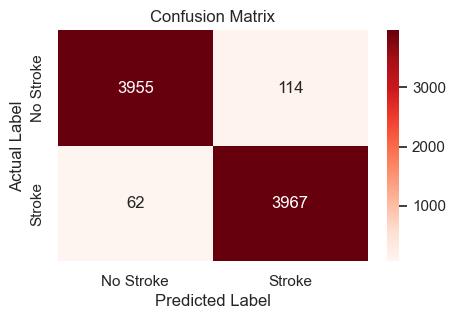

In [65]:
# DF, Rf - TOP 2

soft_voting_model_2 = VotingClassifier(estimators=[
    ('rf', rf_tuned_model), 
    ('dt', dt_tuned_model),
], voting='soft')

# Train the soft voting model with training data
soft_voting_model_2.fit(risk_factors_train, target_train)

# Test the soft voting model with training and testing data
soft_voting_target_pred_train_2 = soft_voting_model_2.predict(risk_factors_train)
soft_voting_target_pred_test_2 = soft_voting_model_2.predict(risk_factors_test)

# Calculate accuracy
soft_voting_train_accuracy_2 = accuracy_score(target_train, soft_voting_target_pred_train_2)
soft_voting_test_accuracy_2 = accuracy_score(target_test, soft_voting_target_pred_test_2)
# Calculate specificity (true negative rate)
test_conf_matrix = confusion_matrix(target_test, soft_voting_target_pred_test_2)
tn, fp, fn, tp = test_conf_matrix.ravel()
specificity_2 = tn / (tn + fp)

# Calculate precision, recall, F1-score
precision_2 = precision_score(target_test, soft_voting_target_pred_test_2, average='macro')
recall_2 = recall_score(target_test, soft_voting_target_pred_test_2, average='macro')
f1_2 = f1_score(target_test, soft_voting_target_pred_test_2, average='macro')

# Classification report
soft_voting_test_report_2 = classification_report(target_test, soft_voting_target_pred_test_2, target_names=target_names, digits=4)

print("Training Accuracy: ", soft_voting_train_accuracy_2)
print("Testing Accuracy: ", soft_voting_test_accuracy_2)
print("Specificity (True Negative Rate): ", specificity_2)
print("\nClassification Report: \n", soft_voting_test_report_2)

# Confusion Matrix
test_conf_matrix = confusion_matrix(target_test, soft_voting_target_pred_test_2)
plt.figure(figsize=(5, 3))
sns.heatmap(test_conf_matrix, annot=True, cmap='Reds', fmt='d', xticklabels=target_names, yticklabels=target_names)
plt.xlabel('Predicted Label')
plt.ylabel('Actual Label')
plt.title('Confusion Matrix')
plt.show()

###### Combination 2 (Best)

Training Accuracy:  0.9882995801432453
Testing Accuracy:  0.9818473697209188
Specificity (True Negative Rate):  0.9751781764561317

Classification Report: 
               precision    recall  f1-score   support

   No Stroke     0.9885    0.9752    0.9818      4069
      Stroke     0.9753    0.9886    0.9819      4029

    accuracy                         0.9818      8098
   macro avg     0.9819    0.9819    0.9818      8098
weighted avg     0.9819    0.9818    0.9818      8098



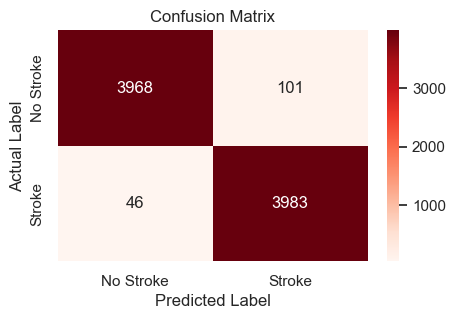

In [23]:
# DF, Rf, XGB - TOP 3

soft_voting_model = VotingClassifier(estimators=[
    ('rf', rf_tuned_model), 
    ('dt', dt_tuned_model),
    ('xgb', xgb_tuned_model),
], voting='soft')

# Train the soft voting model with training data
soft_voting_model.fit(risk_factors_train, target_train)

# Test the soft voting model with training and testing data
soft_voting_target_pred_train = soft_voting_model.predict(risk_factors_train)
soft_voting_target_pred_test = soft_voting_model.predict(risk_factors_test)

# Calculate accuracy
soft_voting_train_accuracy = accuracy_score(target_train, soft_voting_target_pred_train)
soft_voting_test_accuracy = accuracy_score(target_test, soft_voting_target_pred_test)
# Calculate specificity (true negative rate)
test_conf_matrix = confusion_matrix(target_test, soft_voting_target_pred_test)
tn, fp, fn, tp = test_conf_matrix.ravel()
specificity = tn / (tn + fp)

# Calculate precision, recall, F1-score
precision = precision_score(target_test, soft_voting_target_pred_test, average='macro')
recall = recall_score(target_test, soft_voting_target_pred_test, average='macro')
f1 = f1_score(target_test, soft_voting_target_pred_test, average='macro')

# Classification report
soft_voting_test_report = classification_report(target_test, soft_voting_target_pred_test, target_names=target_names, digits=4)

print("Training Accuracy: ", soft_voting_train_accuracy)
print("Testing Accuracy: ", soft_voting_test_accuracy)
print("Specificity (True Negative Rate): ", specificity)
print("\nClassification Report: \n", soft_voting_test_report)

# Confusion Matrix
test_conf_matrix = confusion_matrix(target_test, soft_voting_target_pred_test)
plt.figure(figsize=(5, 3))
sns.heatmap(test_conf_matrix, annot=True, cmap='Reds', fmt='d', xticklabels=target_names, yticklabels=target_names)
plt.xlabel('Predicted Label')
plt.ylabel('Actual Label')
plt.title('Confusion Matrix')
plt.show()

In [54]:
# Append the best soft voting model's metrics
new_row = pd.DataFrame({
    'Model': ['Soft_Voting'],
    'Accuracy': [None],
    'Specificity': [specificity],
    'Precision': [precision],
    'Recall': [recall],
    'F1 Score': [f1]
})

ensmeble_metrics_df = pd.concat([ensmeble_metrics_df, new_row], ignore_index=True)

print("Model Evaluation Metrics without Accuracy:")
print(ensmeble_metrics_df)

Model Evaluation Metrics without Accuracy:
         Model Accuracy  Precision   Recall  F1 Score  Specificity
0  Soft_Voting     None   0.981905  0.98188  0.981847     0.975178


C:\Users\tsfat\AppData\Local\Temp\ipykernel_20200\546640820.py:11: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  ensmeble_metrics_df = pd.concat([ensmeble_metrics_df, new_row], ignore_index=True)


<module 'matplotlib.pyplot' from 'c:\\Users\\tsfat\\AppData\\Local\\Programs\\Python\\Python312\\Lib\\site-packages\\matplotlib\\pyplot.py'>

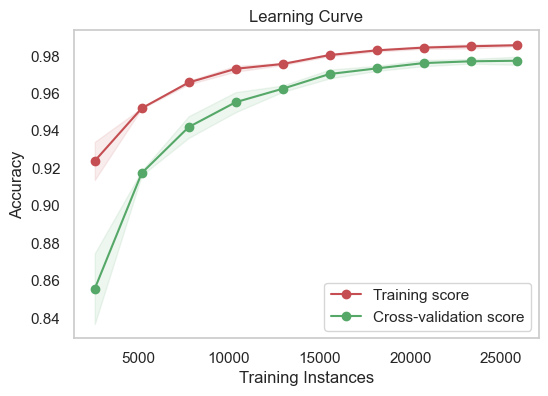

In [81]:
plot_learning_curve(soft_voting_model, risk_factors_train, target_train, 5, scoring='accuracy')

C:\Users\tsfat\AppData\Local\Temp\ipykernel_20200\280330674.py:21: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='Importance', y='Feature', data=feature_importance_df, palette='viridis', ci=None)
C:\Users\tsfat\AppData\Local\Temp\ipykernel_20200\280330674.py:21: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Importance', y='Feature', data=feature_importance_df, palette='viridis', ci=None)


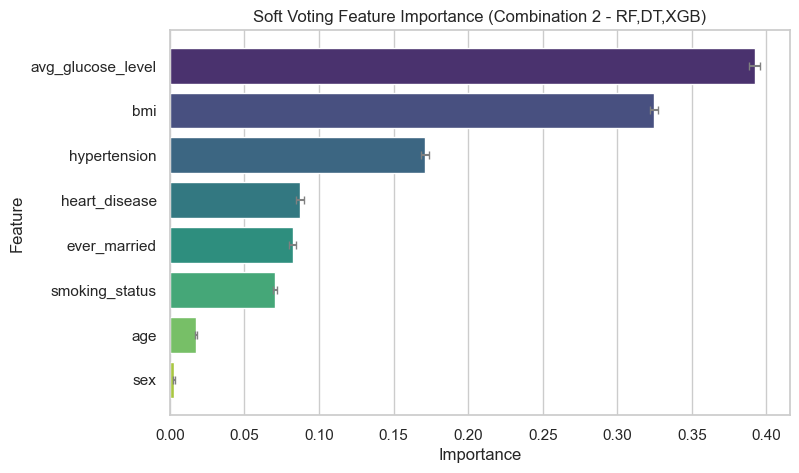

In [67]:
plot_permutation_importance(soft_voting_model, risk_factors_test, target_test, x.columns, 
                            title='Soft Voting Feature Importance (Combination 2 - RF,DT,XGB)', scoring='accuracy')

In [51]:
# Cross-validation
# Perform cross-validation with train and test scores
soft_voting_cv_results = cross_validate(soft_voting_model, x, y, cv=5, return_train_score=True)

# Print cross-validation results
print("Train Accuracy:", soft_voting_cv_results['train_score'])
print("Mean Train Accuracy:", soft_voting_cv_results['train_score'].mean())
print("Test Accuracy:", soft_voting_cv_results['test_score'])
print("Mean Test Accuracy:", soft_voting_cv_results['test_score'].mean())

Train Accuracy: [0.98425537 0.98644727 0.98650901 0.98799086 0.98947271]
Mean Train Accuracy: 0.9869350456902939
Test Accuracy: [0.97493208 0.98468758 0.97048654 0.97937762 0.98851568]
Mean Test Accuracy: 0.9795999012101753


In [55]:
ensmeble_metrics_df.loc[ensmeble_metrics_df['Model'] == 'Soft_Voting', 'Accuracy'] =  soft_voting_cv_results['test_score'].mean()
print(ensmeble_metrics_df)

         Model Accuracy  Precision   Recall  F1 Score  Specificity
0  Soft_Voting   0.9796   0.981905  0.98188  0.981847     0.975178


100%|██████████| 8098/8098 [32:16<00:00,  4.18it/s]

SHAP values shape: (8098, 8, 2)
Risk factors test shape: (8098, 8)


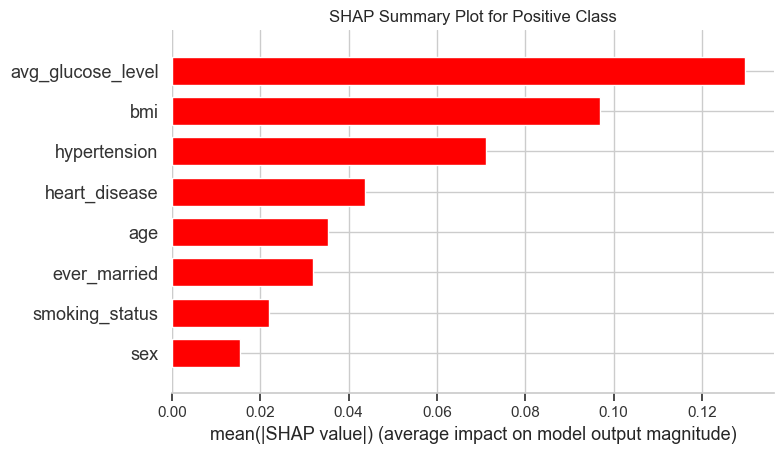

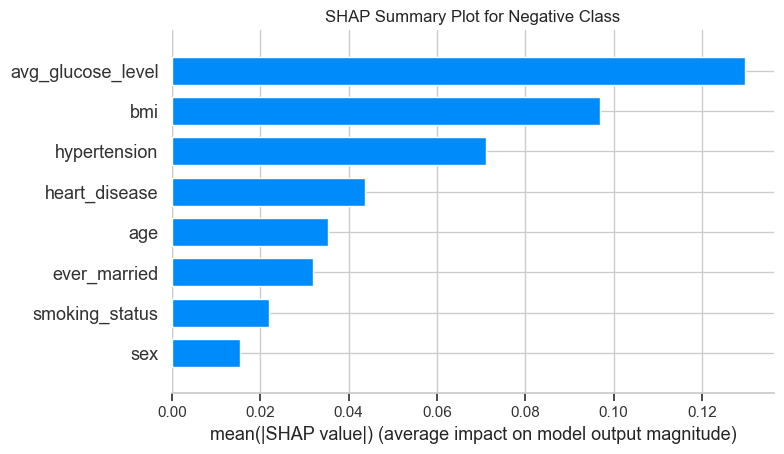

In [93]:
import shap

# Sample a subset of the training data 
background_sample_size = 100
background = shap.sample(risk_factors_train, background_sample_size)

# Initialize the SHAP TreeExplainer
explainer = shap.KernelExplainer(soft_voting_model.predict_proba, background)

# Calculate SHAP values for the test data
shap_values = explainer.shap_values(risk_factors_test)

# Print the shape of SHAP values and risk_factors_test to ensure they match
print("SHAP values shape:", shap_values.shape)
print("Risk factors test shape:", risk_factors_test.shape)

positive_shap_values = shap_values[:, :, 1]  # Select the SHAP values for the positive class
negative_shap_values = shap_values[:, :, 0]  # Negative class
# shap.summary_plot(reshaped_shap_values, risk_factors_test, feature_names=x.columns)

# Plot SHAP summary plot for the positive class
plt.figure(figsize=(10, 6))  # Set the figure size
shap.summary_plot(positive_shap_values, risk_factors_test, feature_names=x.columns, plot_type="bar", color='red', show=False)
plt.title("SHAP Summary Plot for Positive Class")
plt.tight_layout()  # Adjust layout to make room for the title
plt.show()

# Plot SHAP summary plot for the negative class
plt.figure(figsize=(10, 6))  # Set the figure size
shap.summary_plot(negative_shap_values, risk_factors_test, feature_names=x.columns, plot_type="bar", show=False)
plt.title("SHAP Summary Plot for Negative Class")
plt.tight_layout()  # Adjust layout to make room for the title
plt.show()

In [93]:
exp = explain_stroke_instance(risk_factors_train, risk_factors_test, target_test, soft_voting_model, x, 1)

Original Values:    sex   age  hypertension  heart_disease  ever_married  avg_glucose_level  \
0  0.0  37.0           1.0            0.0           1.0              78.92   

    bmi  smoking_status  
0  27.7             1.0  


In [97]:
exp = explain_stroke_instance(risk_factors_train, risk_factors_test, target_test, soft_voting_model, x, 0)

Original Values:    sex   age  hypertension  heart_disease  ever_married  avg_glucose_level  \
0  1.0  62.0           0.0            0.0           1.0              62.56   

    bmi  smoking_status  
0  28.6             0.0  


##### Hard Voting

###### Combination 1

Training Accuracy:  0.9612558656458384
Testing Accuracy:  0.9523339096073105
Specificity (True Negative Rate):  0.9675595969525682

Classification Report: 
               precision    recall  f1-score   support

   No Stroke     0.9394    0.9676    0.9533      4069
      Stroke     0.9662    0.9370    0.9514      4029

    accuracy                         0.9523      8098
   macro avg     0.9528    0.9523    0.9523      8098
weighted avg     0.9527    0.9523    0.9523      8098



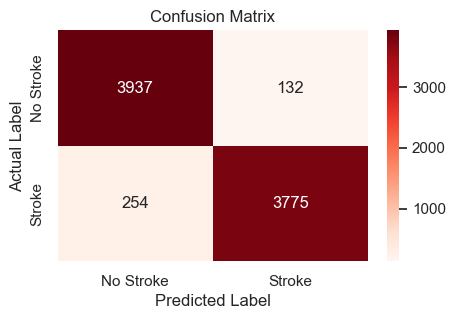

In [68]:
# DF, GB, RF, XGB - TOP 4

hard_voting_model_1 = VotingClassifier(estimators=[
    ('rf', rf_tuned_model), 
    ('gb', gb_tuned_model),
    ('dt', dt_tuned_model),
    ('xgb', xgb_tuned_model),
], voting='hard')

# Train the hard voting model with training data
hard_voting_model_1.fit(risk_factors_train, target_train)

# Test the hard voting model with training and testing data
hard_voting_target_pred_train_1 = hard_voting_model_1.predict(risk_factors_train)
hard_voting_target_pred_test_1 = hard_voting_model_1.predict(risk_factors_test)

# Calculate accuracy
hard_voting_train_accuracy_1 = accuracy_score(target_train, hard_voting_target_pred_train_1)
hard_voting_test_accuracy_1 = accuracy_score(target_test, hard_voting_target_pred_test_1)
# Calculate specificity (true negative rate)
test_conf_matrix = confusion_matrix(target_test, hard_voting_target_pred_test_1)
tn, fp, fn, tp = test_conf_matrix.ravel()
hv_specificity_1 = tn / (tn + fp)

# Calculate precision, recall, F1-score
hv_precision_1 = precision_score(target_test, hard_voting_target_pred_test_1, average='macro')
hv_recall_1 = recall_score(target_test, hard_voting_target_pred_test_1, average='macro')
hv_f1_1 = f1_score(target_test, hard_voting_target_pred_test_1, average='macro')


# Classification report
hard_voting_test_report_1 = classification_report(target_test, hard_voting_target_pred_test_1, target_names=target_names, digits=4)

print("Training Accuracy: ", hard_voting_train_accuracy_1)
print("Testing Accuracy: ", hard_voting_test_accuracy_1)
print("Specificity (True Negative Rate): ", hv_specificity_1)
print("\nClassification Report: \n", hard_voting_test_report_1)

# Confusion Matrix
test_conf_matrix = confusion_matrix(target_test, hard_voting_target_pred_test_1)
plt.figure(figsize=(5, 3))
sns.heatmap(test_conf_matrix, annot=True, cmap='Reds', fmt='d', xticklabels=target_names, yticklabels=target_names)
plt.xlabel('Predicted Label')
plt.ylabel('Actual Label')
plt.title('Confusion Matrix')
plt.show()

###### Combination 2 (Best)

Training Accuracy:  0.9762595702642628
Testing Accuracy:  0.9669054087428994
Specificity (True Negative Rate):  0.9621528631113295

Classification Report: 
               precision    recall  f1-score   support

   No Stroke     0.9717    0.9622    0.9669      4069
      Stroke     0.9622    0.9717    0.9669      4029

    accuracy                         0.9669      8098
   macro avg     0.9669    0.9669    0.9669      8098
weighted avg     0.9670    0.9669    0.9669      8098



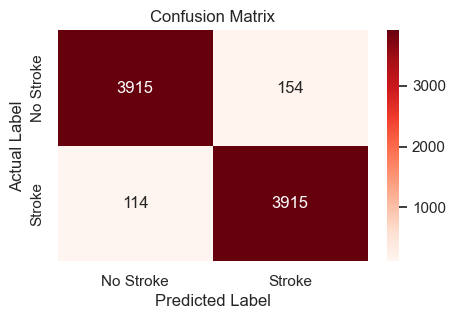

In [69]:
# DF, RF, XGB - TOP 3

hard_voting_model_2 = VotingClassifier(estimators=[
    ('rf', rf_tuned_model), 
    ('dt', dt_tuned_model),
    ('xgb', xgb_tuned_model),
], voting='hard')

# Train the hard voting model with training data
hard_voting_model_2.fit(risk_factors_train, target_train)

# Test the hard voting model with training and testing data
hard_voting_target_pred_train_2 = hard_voting_model_2.predict(risk_factors_train)
hard_voting_target_pred_test_2 = hard_voting_model_2.predict(risk_factors_test)

# Calculate accuracy
hard_voting_train_accuracy_2 = accuracy_score(target_train, hard_voting_target_pred_train_2)
hard_voting_test_accuracy_2 = accuracy_score(target_test, hard_voting_target_pred_test_2)
# Calculate specificity (true negative rate)
test_conf_matrix = confusion_matrix(target_test, hard_voting_target_pred_test_2)
tn, fp, fn, tp = test_conf_matrix.ravel()
hv_specificity_2 = tn / (tn + fp)

# Calculate precision, recall, F1-score
hv_precision_2 = precision_score(target_test, hard_voting_target_pred_test_2, average='macro')
hv_recall_2 = recall_score(target_test, hard_voting_target_pred_test_2, average='macro')
hv_f1_2 = f1_score(target_test, hard_voting_target_pred_test_2, average='macro')

# Classification report
hard_voting_test_report_2 = classification_report(target_test, hard_voting_target_pred_test_2, target_names=target_names, digits=4)

print("Training Accuracy: ", hard_voting_train_accuracy_2)
print("Testing Accuracy: ", hard_voting_test_accuracy_2)
print("Specificity (True Negative Rate): ", hv_specificity_2)
print("\nClassification Report: \n", hard_voting_test_report_2)

# Confusion Matrix
test_conf_matrix = confusion_matrix(target_test, hard_voting_target_pred_test_2)
plt.figure(figsize=(5, 3))
sns.heatmap(test_conf_matrix, annot=True, cmap='Reds', fmt='d', xticklabels=target_names, yticklabels=target_names)
plt.xlabel('Predicted Label')
plt.ylabel('Actual Label')
plt.title('Confusion Matrix')
plt.show()

In [56]:
# Append the best hard voting model's metrics
new_row = pd.DataFrame({
    'Model': ['Hard_Voting'],
    'Accuracy': [None],
    'Specificity': [hv_specificity_2],
    'Precision': [hv_precision_2],
    'Recall': [hv_recall_2],
    'F1 Score': [hv_f1_2]
})

ensmeble_metrics_df = pd.concat([ensmeble_metrics_df, new_row], ignore_index=True)

print("Model Evaluation Metrics without Accuracy:")
print(ensmeble_metrics_df)

Model Evaluation Metrics without Accuracy:
         Model Accuracy  Precision    Recall  F1 Score  Specificity
0  Soft_Voting   0.9796   0.981905  0.981880  0.981847     0.975178
1  Hard_Voting     None   0.966929  0.966929  0.966905     0.962153


<module 'matplotlib.pyplot' from 'c:\\Users\\tsfat\\AppData\\Local\\Programs\\Python\\Python312\\Lib\\site-packages\\matplotlib\\pyplot.py'>

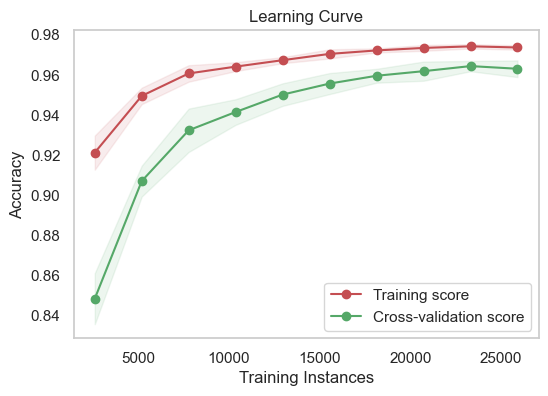

In [103]:
plot_learning_curve(hard_voting_model_2, risk_factors_train, target_train, 5, scoring='accuracy')

C:\Users\tsfat\AppData\Local\Temp\ipykernel_6492\280330674.py:21: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='Importance', y='Feature', data=feature_importance_df, palette='viridis', ci=None)
C:\Users\tsfat\AppData\Local\Temp\ipykernel_6492\280330674.py:21: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Importance', y='Feature', data=feature_importance_df, palette='viridis', ci=None)


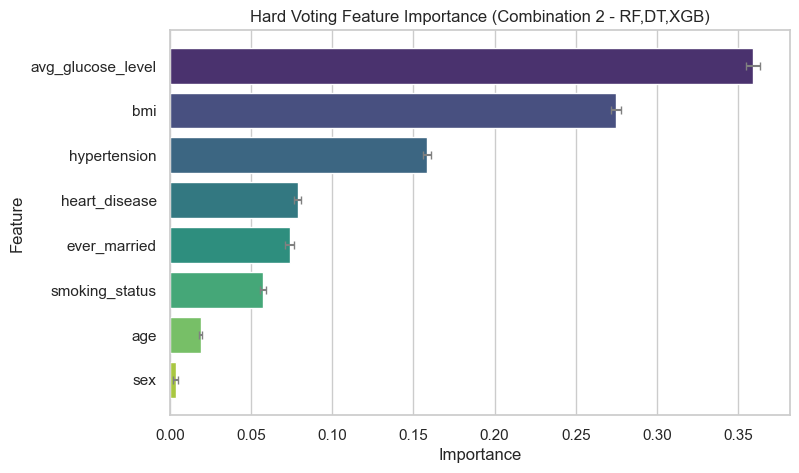

In [104]:
plot_permutation_importance(hard_voting_model_2, risk_factors_test, target_test, x.columns, 
                            title='Hard Voting Feature Importance (Combination 2 - RF,DT,XGB)', scoring='accuracy')

In [58]:
# Cross-validation
# Perform cross-validation with train and test scores
hard_voting_cv_results_2 = cross_validate(hard_voting_model_2, x, y, cv=5, return_train_score=True)

# Print cross-validation results
print("Train Accuracy:", hard_voting_cv_results_2['train_score'])
print("Mean Train Accuracy:", hard_voting_cv_results_2['train_score'].mean())
print("Test Accuracy:", hard_voting_cv_results_2['test_score'])
print("Mean Test Accuracy:", hard_voting_cv_results_2['test_score'].mean())

Train Accuracy: [0.97221536 0.9750247  0.97307977 0.97795752 0.98271178]
Mean Train Accuracy: 0.9761978266238579
Test Accuracy: [0.95714991 0.97369721 0.95455668 0.96949864 0.98357619]
Mean Test Accuracy: 0.9676957273400839


In [59]:
ensmeble_metrics_df.loc[ensmeble_metrics_df['Model'] == 'Hard_Voting', 'Accuracy'] =  hard_voting_cv_results_2['test_score'].mean()
print(ensmeble_metrics_df)

         Model  Accuracy  Precision    Recall  F1 Score  Specificity
0  Soft_Voting    0.9796   0.981905  0.981880  0.981847     0.975178
1  Hard_Voting  0.967696   0.966929  0.966929  0.966905     0.962153


###### Combination 3

Training Accuracy:  0.9585082736478143
Testing Accuracy:  0.9483823166213879
Specificity (True Negative Rate):  0.987220447284345

Classification Report: 
               precision    recall  f1-score   support

   No Stroke     0.9165    0.9872    0.9505      4069
      Stroke     0.9860    0.9092    0.9460      4029

    accuracy                         0.9484      8098
   macro avg     0.9512    0.9482    0.9483      8098
weighted avg     0.9511    0.9484    0.9483      8098



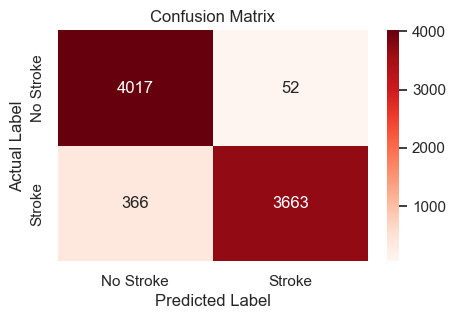

In [70]:
# DF, RF - TOP 2

hard_voting_model_3 = VotingClassifier(estimators=[
    ('rf', rf_tuned_model), 
    ('dt', dt_tuned_model),
], voting='hard')

# Train the hard voting model with training data
hard_voting_model_3.fit(risk_factors_train, target_train)

# Test the hard voting model with training and testing data
hard_voting_target_pred_train_3 = hard_voting_model_3.predict(risk_factors_train)
hard_voting_target_pred_test_3 = hard_voting_model_3.predict(risk_factors_test)

# Calculate accuracy
hard_voting_train_accuracy_3 = accuracy_score(target_train, hard_voting_target_pred_train_3)
hard_voting_test_accuracy_3 = accuracy_score(target_test, hard_voting_target_pred_test_3)
# Calculate specificity (true negative rate)
test_conf_matrix = confusion_matrix(target_test, hard_voting_target_pred_test_3)
tn, fp, fn, tp = test_conf_matrix.ravel()
hv_specificity_3 = tn / (tn + fp)

# Calculate precision, recall, F1-score
hv_precision_3 = precision_score(target_test, hard_voting_target_pred_test_3, average='macro')
hv_recall_3 = recall_score(target_test, hard_voting_target_pred_test_3, average='macro')
hv_f1_3 = f1_score(target_test, hard_voting_target_pred_test_3, average='macro')

# Classification report
hard_voting_test_report_3 = classification_report(target_test, hard_voting_target_pred_test_3, target_names=target_names, digits=4)

print("Training Accuracy: ", hard_voting_train_accuracy_3)
print("Testing Accuracy: ", hard_voting_test_accuracy_3)
print("Specificity (True Negative Rate): ", hv_specificity_3)
print("\nClassification Report: \n", hard_voting_test_report_3)

# Confusion Matrix
test_conf_matrix = confusion_matrix(target_test, hard_voting_target_pred_test_3)
plt.figure(figsize=(5, 3))
sns.heatmap(test_conf_matrix, annot=True, cmap='Reds', fmt='d', xticklabels=target_names, yticklabels=target_names)
plt.xlabel('Predicted Label')
plt.ylabel('Actual Label')
plt.title('Confusion Matrix')
plt.show()

#### Stacking

###### Combination 1 (best)

Training Accuracy:  0.9916337367251173
Testing Accuracy:  0.9864163991108916
Specificity (True Negative Rate):  0.9805849102973704

Classification Report: 
               precision    recall  f1-score   support

   No Stroke     0.9923    0.9806    0.9864      4069
      Stroke     0.9806    0.9923    0.9864      4029

    accuracy                         0.9864      8098
   macro avg     0.9865    0.9864    0.9864      8098
weighted avg     0.9865    0.9864    0.9864      8098



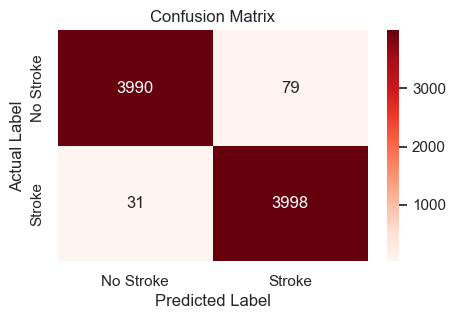

In [71]:
# DF, RF, XGB, GB - TOP 4
from sklearn.ensemble import StackingClassifier

stacking_base_models_1 = [
    ('rf', rf_tuned_model), 
    ('gb', gb_tuned_model),
    ('dt', dt_tuned_model),
    ('xgb', xgb_tuned_model),
]

meta_model = DecisionTreeClassifier(max_depth=5, random_state=42)

stacking_model_1 = StackingClassifier(estimators=stacking_base_models_1, final_estimator=meta_model, cv=5)

# Train the stacking model with training data
stacking_model_1.fit(risk_factors_train, target_train)

# Test the stacking model with training and testing data
stacking_target_pred_train_1 = stacking_model_1.predict(risk_factors_train)
stacking_target_pred_test_1 = stacking_model_1.predict(risk_factors_test)

# Calculate accuracy
stcking_train_accuracy_1 = accuracy_score(target_train, stacking_target_pred_train_1)
stcking_test_accuracy_1 = accuracy_score(target_test, stacking_target_pred_test_1)
# Calculate specificity (true negative rate)
test_conf_matrix = confusion_matrix(target_test, stacking_target_pred_test_1)
tn, fp, fn, tp = test_conf_matrix.ravel()
stack_specificity_1 = tn / (tn + fp)

# Calculate precision, recall, F1-score
stack_precision_1 = precision_score(target_test, stacking_target_pred_test_1, average='macro')
stack_recall_1 = recall_score(target_test, stacking_target_pred_test_1, average='macro')
stack_f1_1 = f1_score(target_test, stacking_target_pred_test_1, average='macro')

# Classification report
stacking_test_report_1 = classification_report(target_test, stacking_target_pred_test_1, target_names=target_names, digits=4)

print("Training Accuracy: ", stcking_train_accuracy_1)
print("Testing Accuracy: ", stcking_test_accuracy_1)
print("Specificity (True Negative Rate): ", stack_specificity_1)
print("\nClassification Report: \n", stacking_test_report_1)

# Confusion Matrix
test_conf_matrix = confusion_matrix(target_test, stacking_target_pred_test_1)
plt.figure(figsize=(5, 3))
sns.heatmap(test_conf_matrix, annot=True, cmap='Reds', fmt='d', xticklabels=target_names, yticklabels=target_names)
plt.xlabel('Predicted Label')
plt.ylabel('Actual Label')
plt.title('Confusion Matrix')
plt.show()

In [60]:
# Append the best stacking model's metrics
new_row = pd.DataFrame({
    'Model': ['Stacking'],
    'Accuracy': [None],
    'Specificity': [stack_specificity_1],
    'Precision': [stack_precision_1],
    'Recall': [stack_recall_1],
    'F1 Score': [stack_f1_1]
})

ensmeble_metrics_df = pd.concat([ensmeble_metrics_df, new_row], ignore_index=True)

print("Model Evaluation Metrics without Accuracy:")
print(ensmeble_metrics_df)

Model Evaluation Metrics without Accuracy:
         Model  Accuracy  Precision    Recall  F1 Score  Specificity
0  Soft_Voting    0.9796   0.981905  0.981880  0.981847     0.975178
1  Hard_Voting  0.967696   0.966929  0.966929  0.966905     0.962153
2     Stacking      None   0.986457  0.986445  0.986416     0.980585


<module 'matplotlib.pyplot' from 'c:\\Users\\tsfat\\AppData\\Local\\Programs\\Python\\Python312\\Lib\\site-packages\\matplotlib\\pyplot.py'>

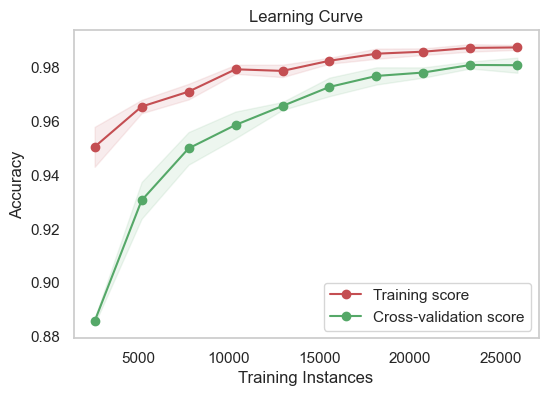

In [119]:
plot_learning_curve(stacking_model_1, risk_factors_train, target_train, 5, scoring='accuracy')

C:\Users\tsfat\AppData\Local\Temp\ipykernel_6492\280330674.py:21: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='Importance', y='Feature', data=feature_importance_df, palette='viridis', ci=None)
C:\Users\tsfat\AppData\Local\Temp\ipykernel_6492\280330674.py:21: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Importance', y='Feature', data=feature_importance_df, palette='viridis', ci=None)


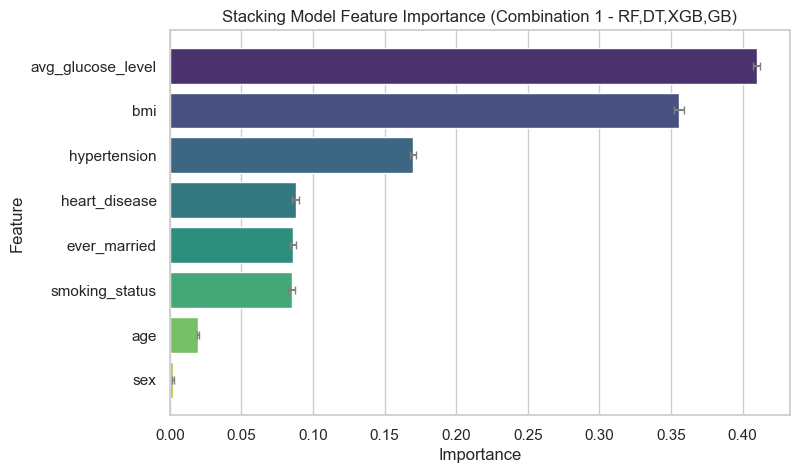

In [120]:
plot_permutation_importance(stacking_model_1, risk_factors_test, target_test, x.columns, 
                            title='Stacking Model Feature Importance (Combination 1 - RF,DT,XGB,GB)', scoring='accuracy')

In [61]:
# Cross-validation
# Perform cross-validation with train and test scores
stacking_cv_results_1 = cross_validate(stacking_model_1, x, y, cv=5, return_train_score=True)

# Print cross-validation results
print("Train Accuracy:", stacking_cv_results_1['train_score'])
print("Mean Train Accuracy:", stacking_cv_results_1['train_score'].mean())
print("Test Accuracy:", stacking_cv_results_1['test_score'])
print("Mean Test Accuracy:", stacking_cv_results_1['test_score'].mean())

Train Accuracy: [0.98635466 0.98956532 0.98709558 0.98941097 0.99147938]
Mean Train Accuracy: 0.9887811805384045
Test Accuracy: [0.97851321 0.98765127 0.97690788 0.98468758 0.9912324 ]
Mean Test Accuracy: 0.9837984687577179


In [62]:
ensmeble_metrics_df.loc[ensmeble_metrics_df['Model'] == 'Stacking', 'Accuracy'] =  stacking_cv_results_1['test_score'].mean()
print(ensmeble_metrics_df)

         Model  Accuracy  Precision    Recall  F1 Score  Specificity
0  Soft_Voting    0.9796   0.981905  0.981880  0.981847     0.975178
1  Hard_Voting  0.967696   0.966929  0.966929  0.966905     0.962153
2     Stacking  0.983798   0.986457  0.986445  0.986416     0.980585


In [63]:
# Store the base model performance df to csv for further use
ensmeble_metrics_df.to_csv('ensemble_model_performance.csv', index=False)

##### Combination 2

Training Accuracy:  0.9916337367251173
Testing Accuracy:  0.9864163991108916
Specificity (True Negative Rate):  0.9798476284099288

Classification Report: 
               precision    recall  f1-score   support

   No Stroke     0.9930    0.9798    0.9864      4069
      Stroke     0.9799    0.9931    0.9864      4029

    accuracy                         0.9864      8098
   macro avg     0.9865    0.9864    0.9864      8098
weighted avg     0.9865    0.9864    0.9864      8098



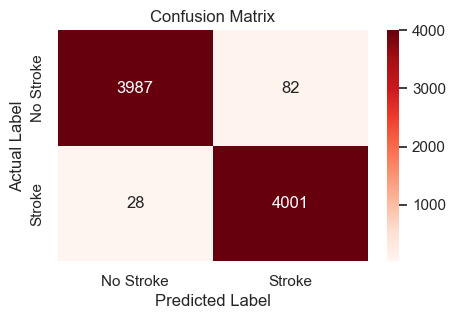

In [72]:
# DF, RF, XGB - TOP 3

stacking_base_models_2 = [
    ('rf', rf_tuned_model), 
    ('dt', dt_tuned_model),
    ('xgb', xgb_tuned_model)
]

meta_model_2 = DecisionTreeClassifier(max_depth=5, random_state=42)

stacking_model_2 = StackingClassifier(estimators=stacking_base_models_2, final_estimator=meta_model_2, cv=5)

# Train the stacking model with training data
stacking_model_2.fit(risk_factors_train, target_train)

# Test the stacking model with training and testing data
stacking_target_pred_train_2 = stacking_model_2.predict(risk_factors_train)
stacking_target_pred_test_2 = stacking_model_2.predict(risk_factors_test)

# Calculate accuracy
stcking_train_accuracy_2 = accuracy_score(target_train, stacking_target_pred_train_2)
stcking_test_accuracy_2 = accuracy_score(target_test, stacking_target_pred_test_2)
# Calculate specificity (true negative rate)
test_conf_matrix = confusion_matrix(target_test, stacking_target_pred_test_2)
tn, fp, fn, tp = test_conf_matrix.ravel()
stack_specificity_2 = tn / (tn + fp)

# Calculate precision, recall, F1-score
stack_precision_2 = precision_score(target_test, stacking_target_pred_test_2, average='macro')
stack_recall_2 = recall_score(target_test, stacking_target_pred_test_2, average='macro')
stack_f1_2 = f1_score(target_test, stacking_target_pred_test_2, average='macro')

# Classification report
stacking_test_report_2 = classification_report(target_test, stacking_target_pred_test_2, target_names=target_names, digits=4)

print("Training Accuracy: ", stcking_train_accuracy_2)
print("Testing Accuracy: ", stcking_test_accuracy_2)
print("Specificity (True Negative Rate): ", stack_specificity_2)
print("\nClassification Report: \n", stacking_test_report_2)

# Confusion Matrix
test_conf_matrix = confusion_matrix(target_test, stacking_target_pred_test_2)
plt.figure(figsize=(5, 3))
sns.heatmap(test_conf_matrix, annot=True, cmap='Reds', fmt='d', xticklabels=target_names, yticklabels=target_names)
plt.xlabel('Predicted Label')
plt.ylabel('Actual Label')
plt.title('Confusion Matrix')
plt.show()


##### Combination 3

Training Accuracy:  0.9864781427512966
Testing Accuracy:  0.9770313657693258
Specificity (True Negative Rate):  0.9783730646350455

Classification Report: 
               precision    recall  f1-score   support

   No Stroke     0.9760    0.9784    0.9772      4069
      Stroke     0.9781    0.9757    0.9769      4029

    accuracy                         0.9770      8098
   macro avg     0.9770    0.9770    0.9770      8098
weighted avg     0.9770    0.9770    0.9770      8098



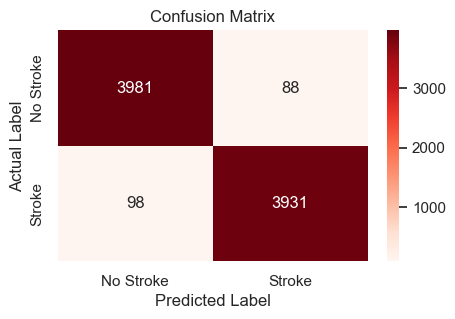

In [73]:
# DF, RF - TOP 2

stacking_base_models_3 = [
    ('rf', rf_tuned_model), 
    ('dt', dt_tuned_model),
]

meta_model_3 = DecisionTreeClassifier(max_depth=5, random_state=42)

stacking_model_3 = StackingClassifier(estimators=stacking_base_models_3, final_estimator=meta_model_3, cv=5)

# Train the stacking model with training data
stacking_model_3.fit(risk_factors_train, target_train)

# Test the stacking model with training and testing data
stacking_target_pred_train_3 = stacking_model_3.predict(risk_factors_train)
stacking_target_pred_test_3 = stacking_model_3.predict(risk_factors_test)

# Calculate accuracy
stcking_train_accuracy_3 = accuracy_score(target_train, stacking_target_pred_train_3)
stcking_test_accuracy_3 = accuracy_score(target_test, stacking_target_pred_test_3)
# Calculate specificity (true negative rate)
test_conf_matrix = confusion_matrix(target_test, stacking_target_pred_test_3)
tn, fp, fn, tp = test_conf_matrix.ravel()
stack_specificity_3 = tn / (tn + fp)

# Calculate precision, recall, F1-score
stack_precision_3 = precision_score(target_test, stacking_target_pred_test_3, average='macro')
stack_recall_3 = recall_score(target_test, stacking_target_pred_test_3, average='macro')
stack_f1_3 = f1_score(target_test, stacking_target_pred_test_3, average='macro')


# Classification report
stacking_test_report_3 = classification_report(target_test, stacking_target_pred_test_3, target_names=target_names, digits=4)

print("Training Accuracy: ", stcking_train_accuracy_3)
print("Testing Accuracy: ", stcking_test_accuracy_3)
print("Specificity (True Negative Rate): ", stack_specificity_3)
print("\nClassification Report: \n", stacking_test_report_3)

# Confusion Matrix
test_conf_matrix = confusion_matrix(target_test, stacking_target_pred_test_3)
plt.figure(figsize=(5, 3))
sns.heatmap(test_conf_matrix, annot=True, cmap='Reds', fmt='d', xticklabels=target_names, yticklabels=target_names)
plt.xlabel('Predicted Label')
plt.ylabel('Actual Label')
plt.title('Confusion Matrix')
plt.show()

In [ ]:
# Function to preprocess and predict custom input
def preprocess_and_predict_custom_input(custom_input):
    # Apply log transformation to BMI and glucose level
    custom_input[5] = np.log1p(custom_input[5])
    custom_input[6] = np.log1p(custom_input[6])
    
    # Convert to numpy array for scaling
    custom_input_array = np.array(custom_input).reshape(1, -1)
    
    # Apply standardization
    standardized_input = scaler.transform(custom_input_array)
    
    # Predict using the stacking model
    prediction = stacking_model.predict(standardized_input)
    
    return prediction[0]

#sex,age,hypertension,heart_disease,ever_married,work_type,Residence_type,avg_glucose_level,bmi,smoking_status,stroke
#custom_input = [1,55,1,1,1,70.09,27.4,0]  # known data, result should be 1
custom_input = [1,53,0,0,0,100.75,27.2,0]  # known data, result should be 0
# 1,53,0,0,0,4,0,100.75,27.2,0,0
predicted_label = preprocess_and_predict_custom_input(custom_input)
print("Custom input:", custom_input)
print("Predicted label:", predicted_label)

Custom input: [1, 53, 0, 0, 0, 4.622518824322705, 3.339321977944068, 0]
Predicted label: 0


c:\Users\tsfat\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


In [ ]:
model = joblib.load('trained_stacking_model.sav')

# Function to preprocess and predict custom input
def preprocess_and_predict_custom_input2(custom_input):
    # Apply log transformation to BMI and glucose level
    custom_input[5] = np.log1p(custom_input[5])
    custom_input[6] = np.log1p(custom_input[6])
    
    # Convert to numpy array for scaling
    custom_input_array = np.array(custom_input).reshape(1, -1)
    
    # Apply standardization
    standardized_input = scaler.transform(custom_input_array)
    print("Standardized input:", standardized_input)
    
    # Predict using the stacking model
    prediction = model.predict(standardized_input)
    
    return prediction[0]

#sex,age,hypertension,heart_disease,ever_married,work_type,Residence_type,avg_glucose_level,bmi,smoking_status,stroke
custom_input = [1,55,1,1,1,70.09,27.4,1]  # known data, result should be 1
# custom_input = [1,77,1,0,1,100.75,30.2,0]  # known data, result should be 0
# 1,53,0,0,0,4,0,100.75,27.2,0,0
predicted_label = preprocess_and_predict_custom_input2(custom_input)
print("Custom input:", custom_input)
print("Predicted label:", predicted_label)

Standardized input: [[ 0.89714541  0.14931287  1.92139868  2.6105012   0.53995097 -1.0539982
  -0.37530725  1.0772534 ]]
Custom input: [1, 55, 1, 1, 1, 4.263946679941392, 3.3463891451671604, 1]
Predicted label: 0


c:\Users\tsfat\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


In [ ]:
exp = explain_stroke_instance(original_risk_factors_train, original_risk_factors_test, risk_factors_test, target_test, stacking_model, x, 1)

Original Values:    sex   age  hypertension  heart_disease  ever_married  avg_glucose_level  \
0  1.0  64.0           1.0            1.0           0.0             217.94   

    bmi  smoking_status  
0  31.9             0.0  


c:\Users\tsfat\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


In [ ]:
exp = explain_stroke_instance(original_risk_factors_train, original_risk_factors_test, risk_factors_test, target_test, stacking_model, x, 0)

c:\Users\tsfat\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


Original Values:    sex   age  hypertension  heart_disease  ever_married  avg_glucose_level  \
0  1.0  65.0           1.0            0.0           1.0             125.78   

    bmi  smoking_status  
0  36.6             0.0  


### Model Evaluation/Result

In [88]:
import pandas as pd
import plotly.express as px

# Load the CSV file
file_path = 'ensemble_model_performance.csv' 
df = pd.read_csv(file_path)

# Convert the DataFrame to a long format suitable for plotting
df_long = df.melt(id_vars='Model', var_name='Metric', value_name='Score')

df_long['Score'] = df_long['Score'] * 100

# Plot the graph
fig = px.bar(df_long, x='Metric', y='Score', color='Model', barmode='group', 
             category_orders={"Metric": ["Accuracy", "Precision", "Recall", "F1 Score", "Specificity"]},
             labels={"Score": "Score (%)", "Metric": "Evaluation Metric"},
             title="Ensemble Model Evaluation Metrics Score",
             width=1300, height=700, 
             color_discrete_sequence=px.colors.qualitative.Set3)

fig.update_traces(texttemplate='%{y:.2f}', textposition='outside')

# Layout
fig.update_layout(
    xaxis_title="Evaluation Metric",
    yaxis_title="Score (%)",
    legend_title="Models",
    title_x=0.5,
    title_font_size=20,
    xaxis_tickangle=-45,
    paper_bgcolor='white', 
    plot_bgcolor='white', 
    font=dict(color='black'), 
    xaxis=dict(showgrid=True, gridcolor='lightgrey'), 
    yaxis=dict(showgrid=True, gridcolor='lightgrey'),   
    margin=dict(t=50, b=150)
)

# Show plot
fig.show()

### Save The Model

In [89]:
import joblib
from joblib import dump

joblib.dump(soft_voting_model, 'trained_sv_model.sav')

['trained_sv_model.sav']

### Addtional Validation & Export Codes (Not important)

In [10]:
import numpy as np
import pandas as pd
import plotly.graph_objs as go
import streamlit as st
from sklearn.metrics import roc_curve, roc_auc_score
from sklearn.ensemble import VotingClassifier

In [9]:
# Check inverse transform value
transformed_values = np.array([
    [-1.1146465042123073, -2.4031268359873232, -0.5204541934529272, -0.38306820131416996, 0.5399509694794392, -1.408965296702892, -0.06534047628540782, 1.0772534002179794]
])

# {"sex": -1.1146465042123073, "age": -2.4031268359873232, "hypertension": -0.5204541934529272, "heart_disease": -0.38306820131416996, "ever_married": -1.8520200101947943, "avg_glucose_level": -10.995056814031164, "bmi": -16.392793410534946, "smoking_status": -0.9282866963312929}
# {"sex": -1.1146465042123073, "age": 0.6692542870901912, "hypertension": 1.9213986794218147, "heart_disease": 2.6105012020558167, "ever_married": -1.8520200101947943, "avg_glucose_level": 1.1248329402740056, "bmi": 0.3432343007936434, "smoking_status": -0.9282866963312929, "prediction_result": 1}
# Inverse transform the provided values
inverse_scaled_values = scaler.inverse_transform(transformed_values)
# Reverse the log transformation for avg_glucose_level and bmi
inverse_scaled_values[:, 5] = np.expm1(inverse_scaled_values[:, 5])
inverse_scaled_values[:, 6] = np.expm1(inverse_scaled_values[:, 6])
# Print the inverse transformed values
print(inverse_scaled_values)

[[ 0.          1.          0.          0.          1.         60.0529767
  29.29661124  1.        ]]


In [ ]:
# Plot roc auc curve for deployment
y_pred_proba = soft_voting_model.predict_proba(risk_factors_test)[:, 1] 

# Generate ROC curve values
fpr, tpr, thresholds = roc_curve(target_test, y_pred_proba)
roc_auc = roc_auc_score(target_test, y_pred_proba)

# Choose a threshold to highlight
highlight_index = np.argmax(tpr - fpr) 
highlight_threshold = thresholds[highlight_index]
highlight_fpr = fpr[highlight_index]
highlight_tpr = tpr[highlight_index]

# Create ROC curve plot with colors and highlighted point
trace0 = go.Scatter(x=fpr, y=tpr, mode='lines', name='ROC Curve', line=dict(color='blue'))
trace1 = go.Scatter(x=[0, 1], y=[0, 1], mode='lines', name='Random Chance', line=dict(dash='dash', color='red'))
highlight_trace = go.Scatter(x=[highlight_fpr], y=[highlight_tpr], mode='markers', name='Highlight Point',
                             marker=dict(color='orange', size=10),
                             text=[f"threshold: {highlight_threshold:.2f}<br>FPR: {highlight_fpr:.2f}<br>TPR: {highlight_tpr:.2f}"],
                             hoverinfo='text')

layout = go.Layout(
    title='ROC AUC Curve',
    xaxis=dict(title='False Positive Rate', gridcolor='lightgrey'),
    yaxis=dict(title='True Positive Rate', gridcolor='lightgrey'),
    annotations=[
        dict(
            x=0.6, y=0.4,
            xref='paper', yref='paper',
            text=f'roc-auc-score: 96.957%',
            showarrow=False,
            font=dict(size=12)
        )
    ],
    plot_bgcolor='white',
    width=700,
    height=600
)

fig = go.Figure(data=[trace0, trace1, highlight_trace], layout=layout)

# Display the plot in Jupyter notebook
fig.write_html('roc_auc_curve.html')

In [ ]:
# Generate confusion matrix image for deployment
cm = confusion_matrix(target_test, soft_voting_target_pred_test)

# Calculate the percentages
cm_percent = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis] * 100

# Create DataFrame for better visualization
cm_df = pd.DataFrame(cm, index=['Low Risk', 'High Risk'], columns=['Low Risk', 'High Risk'])

# Plot confusion matrix
plt.figure(figsize=(6, 6))
ax = sns.heatmap(cm_df, annot=False, fmt='', cmap='Blues', cbar=False)

for i in range(cm.shape[0]):
    for j in range(cm.shape[1]):
        ax.text(j + 0.5, i + 0.5, f'{cm_percent[i, j]:.1f}%', 
                horizontalalignment='center', 
                verticalalignment='center', 
                color='black', fontsize=18)
        ax.text(j + 0.5, i + 0.55, f'\n{cm[i, j]}', 
                horizontalalignment='center', 
                verticalalignment='center', 
                color='black', fontsize=12)

ax.set_xlabel('Predicted', fontsize=18)
ax.set_ylabel('Observed', fontsize=18)
ax.set_title('Confusion Matrix', fontsize=18)
plt.tight_layout()

# Save the figure
conf_matrix_filename = 'confusion_matrix.png'
plt.savefig(conf_matrix_filename)
plt.close()

In [ ]:
from sklearn.metrics import precision_recall_curve, auc

# Plot pr auc for deployment
# Make predictions
y_pred_proba = soft_voting_model.predict_proba(risk_factors_test)[:, 1]  # Get probability estimates for the positive class

# Generate Precision-Recall curve values
precision, recall, thresholds = precision_recall_curve(target_test, y_pred_proba)
pr_auc = auc(recall, precision)

report = classification_report(target_test, soft_voting_target_pred_test, output_dict=True)
precision_report = report['1']['precision']
recall_report = report['1']['recall']

# Create PR curve plot with colors
trace0 = go.Scatter(x=recall, y=precision, mode='lines', name='PR Curve', line=dict(color='blue'))

layout = go.Layout(
    title='PR AUC Curve',
    xaxis=dict(title='Recall', gridcolor='lightgrey'),
    yaxis=dict(title='Precision', gridcolor='lightgrey'),
    annotations=[
        dict(
            x=0.6, y=0.4,
            xref='paper', yref='paper',
            text=f'pr-auc-score: 0.98<br>cutoff: 0.50<br>precision: {precision_report:.2f}<br>recall: {recall_report:.2f}',
            showarrow=False,
            font=dict(size=12)
        )
    ],
    plot_bgcolor='white',
    width=700,  
    height=600  
)
fig = go.Figure(data=trace0, layout=layout)

# Save the plot to an HTML file
fig.write_html('pr_auc_curve.html')

# fig.show()

In [ ]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, log_loss, average_precision_score

# Save metrics for deployment
# Calculate metrics
accuracy = accuracy_score(target_test, soft_voting_target_pred_test) * 100
precision = precision_score(target_test, soft_voting_target_pred_test) * 100
recall = recall_score(target_test, soft_voting_target_pred_test) * 100
f1 = f1_score(target_test, soft_voting_target_pred_test) * 100
roc_auc = roc_auc_score(target_test, soft_voting_target_pred_test) * 100
pr_auc = average_precision_score(target_test, soft_voting_target_pred_test) * 100

# Calculate Specificity
tn, fp, fn, tp = confusion_matrix(target_test, soft_voting_target_pred_test).ravel()
specificity = tn / (tn + fp) * 100

# Create DataFrame
metrics_df = pd.DataFrame({
    "Metric": ["accuracy", "precision", "recall", "f1", "specificity", "roc_auc_score", "pr_auc_score", ],
    "Score": [f"{accuracy:.3f}%", f"{precision:.3f}%", f"{recall:.3f}%", f"{f1:.3f}%", f"{roc_auc:.3f}%", f"{pr_auc:.3f}%", f"{specificity:.3f}%"]
})

# Save to CSV
metrics_df.to_csv('metrics.csv', index=False)

In [26]:
import shap

# calculate SHAP values - testing
def shap_feature_contributions(custom_input, model, training_data, feature_names, scaler):
    # Ensure consistent preprocessing
    # custom_input_scaled = preprocess_input(custom_input, scaler)
    # training_data_scaled = preprocess_input(training_data.values, scaler)
    
    # KernelExplainer expects a function that returns the model's output
    def model_predict(data):
        return model.predict_proba(data)[:, 1]  # Assuming binary classification and we want the positive class

    # Create a SHAP explainer
    explainer = shap.KernelExplainer(model_predict, training_data)
    
    # Get SHAP values for the custom input
    shap_values = explainer.shap_values(custom_input)
    
    # Convert SHAP values to DataFrame for better readability
    shap_df = pd.DataFrame({
        'Feature': feature_names,
        'SHAP Value': shap_values[0] * 100
    }).sort_values(by='SHAP Value', key=abs, ascending=False)

    # Calculate the expected value and the final prediction
    expected_value = explainer.expected_value
    final_prediction = shap_values.sum() + expected_value

    # Add the "Average of population" as the first row
    average_population_df = pd.DataFrame({
        'Feature': ['Average of population'],
        'SHAP Value': [expected_value]
    })
    
    shap_df = pd.concat([average_population_df, shap_df], ignore_index=True)

    return shap_df, final_prediction

# Example usage:
custom_input = np.array([[0.8971454144618476,0.9528586984511925,1.9213986794218147,-0.38306820131416996,-1.8520200101947943,-0.28142287872825145,-1.3227265612435113,1.0772534002179794]])
# custom_input = np.array([[-1.1146465042123073, -1.1269069848628173, -0.5204541934529272, -0.38306820131416996, -1.8520200101947943, 0.18595422584978583, -1.181043961181701, -0.9282866963312929]])

feature_names = ['sex', 'age', 'hypertension', 'heart_disease', 'ever_married', 'avg_glucose_level', 'bmi', 'smoking_status']
class_names = ['Low Risk', 'High Risk']

shap_df, final_prediction = shap_feature_contributions(custom_input, soft_voting_model, risk_factors_train_df, feature_names, scaler)
print(shap_df)
print("Final Prediction:", final_prediction * 100)

Using 32392 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.
100%|██████████| 1/1 [01:05<00:00, 65.19s/it]

                 Feature  SHAP Value
0  Average of population    0.496057
1           hypertension   28.024055
2                    bmi   15.495082
3           ever_married    5.377590
4      avg_glucose_level   -1.311742
5          heart_disease   -1.219568
6                    sex   -0.802865
7                    age   -0.487523
8         smoking_status   -0.451875
Final Prediction: 94.22888460437376
